In [1]:
import numpy as np
import scipy.sparse as sp
from scipy.spatial.distance import cdist
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch.nn import Parameter
from torch_scatter import scatter_add
from torch_geometric.utils import degree
from torch.nn import Linear, Parameter
import torch.optim as optim
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torch_geometric.nn import MessagePassing
from torch_geometric.utils import remove_self_loops
import seaborn as sns
import pickle

In [3]:
soccer_matrix_filename = r'C:\Users\Mahender\Documents\MS docs\Final docs\Rowan University\Research_project\ASTGCN\Coords_Influence_3.npz'
data = np.load(soccer_matrix_filename)
data['data'].shape

(5750, 22, 3)

In [4]:
# In this data, the first dimension is time frame (seconds), second dimension is player (22 players in a soccer game), 
# third dimension has player influence on the field, x coordinate and y coordinate in respective order

X = data['data']

# Define adjacancy matrix
def create_adjacency_matrices(X, distance_threshold=15):
    num_time_frames = X.shape[0]
    num_players = X.shape[1]
    adjacency_matrices = []

    for t in range(num_time_frames):
        coordinates = X[t, :, 1:3]  # Extract x, y coordinates
        distances = cdist(coordinates, coordinates, 'euclidean')
        adjacency_matrix = (distances < distance_threshold) & (distances != 0)
        # adjacency_matrices.append(sp.csr_matrix(adjacency_matrix, dtype=np.int8))
        adjacency_matrices.append(adjacency_matrix.astype(np.int8))

    return adjacency_matrices

# Create adjacency matrices for each time frame
adj_matrices = create_adjacency_matrices(X, distance_threshold=15)

In [5]:
# 'edge_indices' is a list of 2-row tensors, one for each time frame

def create_edge_indices_and_distances(X, distance_threshold=15):
    num_time_frames = X.shape[0]
    edge_indices = []
    edge_distances = []

    for t in range(num_time_frames):
        coordinates = X[t, :, 1:3]  # Extract x, y coordinates
        distances = cdist(coordinates, coordinates, 'euclidean')
        adjacency_matrix = (distances < distance_threshold) & (distances != 0)

        edges = []
        dists = []
        for i in range(adjacency_matrix.shape[0]):
            for j in range(adjacency_matrix.shape[1]):
                if adjacency_matrix[i, j]:
                    edges.append((i, j))
                    dists.append(distances[i, j])

        edge_index_tensor = torch.tensor(edges, dtype=torch.long).t().contiguous()
        edge_distances_tensor = torch.tensor(dists, dtype=torch.float)
        
        edge_indices.append(edge_index_tensor)
        edge_distances.append(edge_distances_tensor)

    return edge_indices, edge_distances

# Use the modified function to create both edge indices and distances for each time frame
edge_indices, edge_distances = create_edge_indices_and_distances(X, distance_threshold=15)

In [6]:
def pad_edge_data(edge_indices, edge_distances, max_edges):
    padded_edge_indices = []
    padded_edge_distances = []

    for idx, dist in zip(edge_indices, edge_distances):
        # Padding edge indices
        pad_size_idx = max_edges - idx.size(1)
        if pad_size_idx > 0:
            pad_idx = torch.full((2, pad_size_idx), -1, dtype=idx.dtype, device=idx.device)
            padded_idx = torch.cat([idx, pad_idx], dim=1)
        else:
            padded_idx = idx

        # Padding edge distances
        pad_size_dist = max_edges - dist.size(0)
        if pad_size_dist > 0:
            pad_dist = torch.full((pad_size_dist,), float('inf'), dtype=dist.dtype, device=dist.device)
            padded_dist = torch.cat([dist, pad_dist])
        else:
            padded_dist = dist

        padded_edge_indices.append(padded_idx)
        padded_edge_distances.append(padded_dist)

    return padded_edge_indices, padded_edge_distances

In [7]:
max_edges = max(ei.size(1) for ei in edge_indices)

padded_edge_indices, padded_edge_distances = pad_edge_data(edge_indices, edge_distances, max_edges)

In [9]:
class CustomGCNLayer(MessagePassing):
    def __init__(self, in_channels, out_channels, aggr='add'):
        super(CustomGCNLayer, self).__init__(aggr=aggr)
        self.lin = Linear(in_channels, out_channels)  # Linear transformation
        self.bn = torch.nn.BatchNorm1d(out_channels)  # Add batch normalization
        self.reset_parameters()  # Initialize parameters
        
    def reset_parameters(self):
        self.lin.reset_parameters()
        self.bn.reset_parameters()
        
    def forward(self, x, edge_index, edge_weight=None):
        # Handle masking for padded edges
        mask = edge_index[0] != -1  # Assuming -1 is the padding value for edge_index
        edge_index = edge_index[:, mask]
        edge_weight = edge_weight[mask]
        
        # Optionally remove self-loops from the graph.
        edge_index, edge_weight = remove_self_loops(edge_index, edge_weight)
        
        # Apply linear transformation to node features
        x = self.lin(x)        
        
        # Reshape x to apply batch normalization across the correct dimension (features)
        x = x.view(-1, self.lin.out_features)  
        x = self.bn(x)  # Apply batch normalization
        x = x.view(-1, x.size(1))  # Reshape back if necessary
        
        # Call the propagate method, which uses the message and aggregate functions.
        return self.propagate(edge_index, size=(x.size(0), x.size(0)), x=x, edge_weight=edge_weight)
    
    def message(self, x_j, edge_index, size, edge_weight):
        
        # Compute node degrees
        row, col = edge_index
        deg = degree(row, size[0], dtype=x_j.dtype)

        # Compute normalization factor
        norm = deg[row].pow(-0.5) * deg[col].pow(-0.5)
        
        if edge_weight is not None:
     
            # Ensure edge_weight is in the correct shape
            edge_weight = edge_weight.view(-1, 1)

            # Convert distances to weights and ensure no division by zero
            edge_weight = 1.0 / edge_weight

            # If edge_weight is 1/0 i.e. distance is 0 (not possible in most cases), then converting weight to 0
            edge_weight[torch.isinf(edge_weight)] = 0

            # Compute normalization factor
            norm = norm * edge_weight.squeeze()

            # Apply normalization to the messages
        return norm.view(-1, 1) * x_j
    
    def update(self, aggr_out):
        # Define how node features are updated based on aggregated messages.
        # aggr_out is the result of aggregating the messages from the neighbors.
        return aggr_out

In [12]:
X_influence = X[:, :, 0]
num_node_features = 1  # One feature per player (influence)
num_output_features = 16  # Desired number of output features
model = CustomGCNLayer(num_node_features, num_output_features)

# Reshape x to have dimensions [num_players, num_node_features]
time_frame = 0
x = torch.tensor(X_influence[time_frame], dtype=torch.float).view(-1, num_node_features)
edge_index = padded_edge_indices[time_frame]
edge_weight = padded_edge_distances[time_frame]  # Extract edge distances for the current time frame
output = model(x, edge_index, edge_weight)

In [14]:
outputs = []

for time_frame in range(X.shape[0]):
    x = torch.tensor(X_influence[time_frame], dtype=torch.float).view(-1, num_node_features)
    edge_index = padded_edge_indices[time_frame]
    edge_weight = padded_edge_distances[time_frame]  # Extract edge distances for the current time frame
    output = model(x, edge_index, edge_weight)
    outputs.append(output)

In [15]:
# Function to create sequences of 12 seconds for input and 3 seconds for output
def create_sequences(input_data, output_data, n_steps_in, n_steps_out):
    X, y = [], []
    for i in range(len(input_data) - n_steps_in - n_steps_out + 1):
        # gather input and output parts of the pattern
        seq_x = input_data[i:(i + n_steps_in)]
        seq_y = output_data[(i + n_steps_in):(i + n_steps_in + n_steps_out)]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

# Finding the minimum and maximum values
feature = X[:, :, 0]
min_inf_value = np.min(feature)
max_inf_value = np.max(feature)

# Applying Min-Max normalization
X_influence[:, :] = (feature - min_inf_value) / (max_inf_value - min_inf_value)

# Convert the data into sequences
n_steps_in, n_steps_out = 3, 3  # Assuming one step is one second

# Generate input and output sequences for the LSTM
X_sequences, y_sequences = create_sequences(X_influence, X_influence, n_steps_in, n_steps_out)

# Directly use the indices from generated sequences to align edge_distances
edge_indices_sequences = [padded_edge_indices[i:(i + n_steps_in)] for i in range(len(X_sequences))]
edge_indices_sequences_y = [padded_edge_indices[i:(i + n_steps_out)] for i in range(len(y_sequences))]

edge_distances_sequences = [padded_edge_distances[i:(i + n_steps_in)] for i in range(len(X_sequences))]
edge_distances_sequences_y = [padded_edge_distances[i:(i + n_steps_out)] for i in range(len(y_sequences))]

# # Convert edge_distances_sequences into a suitable format if necessary, e.g., a tensor or list of tensors
# edge_distances_sequences = [np.array(seq) for seq in edge_distances_sequences]  # Example conversion

# Split the data into training and test sets (80%-20% split)
n_train = int(0.8 * X_sequences.shape[0])
X_train, y_train = X_sequences[:n_train], y_sequences[:n_train]
X_test, y_test = X_sequences[n_train:], y_sequences[n_train:]

edge_indices_train = edge_indices_sequences[:n_train]
edge_indices_train_y = edge_indices_sequences_y[:n_train]

edge_indices_test = edge_indices_sequences[n_train:]
edge_indices_test_y = edge_indices_sequences_y[n_train:]

edge_distances_train = edge_distances_sequences[:n_train]
edge_distances_train_y = edge_distances_sequences_y[:n_train]

edge_distances_test = edge_distances_sequences[n_train:]
edge_distances_test_y = edge_distances_sequences_y[n_train:]

# Converting inputs to tensors and ensuring correct data types
X_train = torch.tensor(X_train, dtype=torch.float)
y_train = torch.tensor(y_train, dtype=torch.float)
X_test = torch.tensor(X_test, dtype=torch.float)
y_test = torch.tensor(y_test, dtype=torch.float)

In [17]:
class GCN_LSTM_Model(nn.Module):
    def __init__(self, num_node_features, gcn_out_features, lstm_hidden_size, output_features, num_nodes):
        super(GCN_LSTM_Model, self).__init__()
        self.gcn = CustomGCNLayer(num_node_features, gcn_out_features)
        # Adjust LSTM input size based on GCN output for each node
        self.lstm = nn.LSTM(input_size=gcn_out_features * num_nodes, hidden_size=lstm_hidden_size, batch_first=True, num_layers=2) #, dropout=0.02)
        self.tanh = nn.Tanh()
        self.relu = nn.ReLU()  # ReLU activation

        # Output layer matches prediction space
        self.fc = nn.Linear(lstm_hidden_size, n_steps_out * num_nodes * num_node_features)  # Adjust num_features as needed

    def forward(self, x_sequences, edge_indices_sequences, edge_distances_sequences):
        total_sequences, seq_length, num_nodes = x_sequences.shape
        gcn_outputs = []

        for sequence_idx in range(total_sequences):
            sequence_gcn_outputs = []

            for t in range(seq_length):
                # Assuming a single feature per node, reshape to match GCN input expectation
                x_t = x_sequences[sequence_idx, t, :].view(-1, 1)  # Reshape: [num_nodes, num_node_features]
                edge_index_t = edge_indices_sequences[sequence_idx][t]
                edge_distance_t = edge_distances_sequences[sequence_idx][t]
                gcn_output = self.gcn(x_t, edge_index_t, edge_distance_t)
                # Flatten GCN output to prepare for LSTM
                gcn_output_flat = gcn_output.view(-1)  # Flatten: [gcn_out_features * num_nodes]
                sequence_gcn_outputs.append(gcn_output_flat.unsqueeze(0))

            # Concatenate GCN outputs for the sequence
            sequence_gcn_output = torch.cat(sequence_gcn_outputs, dim=0).unsqueeze(0)  # Add batch dimension
            gcn_outputs.append(sequence_gcn_output)

        # Prepare for LSTM processing
        gcn_outputs_tensor = torch.cat(gcn_outputs, dim=0)  # Shape: [total_sequences, seq_length, gcn_out_features * num_nodes]
        gcn_outputs_tensor = self.tanh(gcn_outputs_tensor)
        lstm_out, _ = self.lstm(gcn_outputs_tensor)
        # Use the last LSTM output for prediction
        
        lstm_out = self.tanh(lstm_out)  # Apply ReLU non-linearity to LSTM outputs
        
        lstm_out = lstm_out[:, -1, :]
        out = self.fc(lstm_out)
        out = out.view(-1, n_steps_out, num_nodes, num_node_features)  # Reshape to match target
        out_squeezed = out.squeeze(-1)  # Remove the last dimension if it is of size 1

        return out_squeezed

In [18]:
# Model parameters
num_node_features = 1
gcn_out_features = 128
lstm_hidden_size = 256
output_features = y_train.shape[-1]  # The size of your output feature vector
num_nodes = 22  # Number of players
# seq_length = 12
# pred_length = 3

# Instantiate model
model = GCN_LSTM_Model(num_node_features=num_node_features,
                       gcn_out_features=gcn_out_features,
                       lstm_hidden_size=lstm_hidden_size,
                       output_features=output_features,
                       num_nodes=num_nodes)

In [19]:
# Determine the new training and validation sizes
n_train_new = int(0.8 * len(X_train))  # 80% of the current training data for the new training set

# Split the data for training and validation
X_train_new, y_train_new = X_train[:n_train_new], y_train[:n_train_new]
X_val, y_val = X_train[n_train_new:], y_train[n_train_new:]

edge_indices_train_new = edge_indices_train[:n_train_new]
edge_indices_val = edge_indices_train[n_train_new:]

edge_distances_train_new = edge_distances_train[:n_train_new]
edge_distances_val = edge_distances_train[n_train_new:]

In [20]:
# Training setup
criterion = nn.MSELoss()
# optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
# optimizer = torch.optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)  # Example for L2 regularization
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001, weight_decay=1e-5)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', factor=0.1, patience=5)

num_epochs = 40
epochs_no_improve = 0
n_epochs_stop = 5
best_val_loss = 1
stop_at_epoch = 0

train_losses = []
val_losses = []

for epoch in range(num_epochs):
    model.train()
    optimizer.zero_grad()

    # Forward pass on the training data
    outputs = model(X_train_new, edge_indices_train_new, edge_distances_train_new)
    loss = criterion(outputs, y_train_new)
    
    # Backward and optimize
    loss.backward()
    optimizer.step()

    # Validation phase
    model.eval()  # Set the model to evaluation mode
    with torch.no_grad():  # Turn off gradients for validation, saves memory and computations
        val_outputs = model(X_val, edge_indices_val, edge_distances_val)
        val_loss = criterion(val_outputs, y_val)
    
    scheduler.step(val_loss)
    
    train_losses.append(loss)
    val_losses.append(val_loss)
    
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item()}, Val Loss: {val_loss.item()}')
    
    # Early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        epochs_no_improve = 0
        # Save the model if you want
    else:
        epochs_no_improve += 1
        if epochs_no_improve == n_epochs_stop:
            print('Early stopping!')
            stop_at_epoch = epoch+1
            break  # Stop training

Epoch [1/40], Loss: 0.026367466896772385, Val Loss: 0.02339347079396248
Epoch [2/40], Loss: 0.02056749351322651, Val Loss: 0.017861826345324516
Epoch [3/40], Loss: 0.01480188686400652, Val Loss: 0.012906038202345371
Epoch [4/40], Loss: 0.010165983811020851, Val Loss: 0.010818193666636944
Epoch [5/40], Loss: 0.009413203224539757, Val Loss: 0.009063439443707466
Epoch [6/40], Loss: 0.008167046122252941, Val Loss: 0.008022447116672993
Epoch [7/40], Loss: 0.007121410686522722, Val Loss: 0.007898427546024323
Epoch [8/40], Loss: 0.006960551720112562, Val Loss: 0.007734342943876982
Epoch [9/40], Loss: 0.006737971678376198, Val Loss: 0.007304213475435972
Epoch [10/40], Loss: 0.00626489007845521, Val Loss: 0.00679573230445385
Epoch [11/40], Loss: 0.005769335199147463, Val Loss: 0.00637002382427454
Epoch [12/40], Loss: 0.0054086679592728615, Val Loss: 0.006042785011231899
Epoch [13/40], Loss: 0.005163983441889286, Val Loss: 0.005765536334365606
Epoch [14/40], Loss: 0.004939447157084942, Val Loss:

In [22]:
# Testing phase
model.eval()  # Set the model to evaluation mode
with torch.no_grad():  # Turn off gradients for testing, saves memory and computations
    # Generate predictions with the test data
    test_outputs = model(X_test, edge_indices_test, edge_distances_test)
    # Compute the loss (or other metrics) on the test set
    test_loss = criterion(test_outputs, y_test)
    # If you have other metrics, calculate them here

print(f'Test Loss: {test_loss.item()}')

Test Loss: 0.005810308735817671


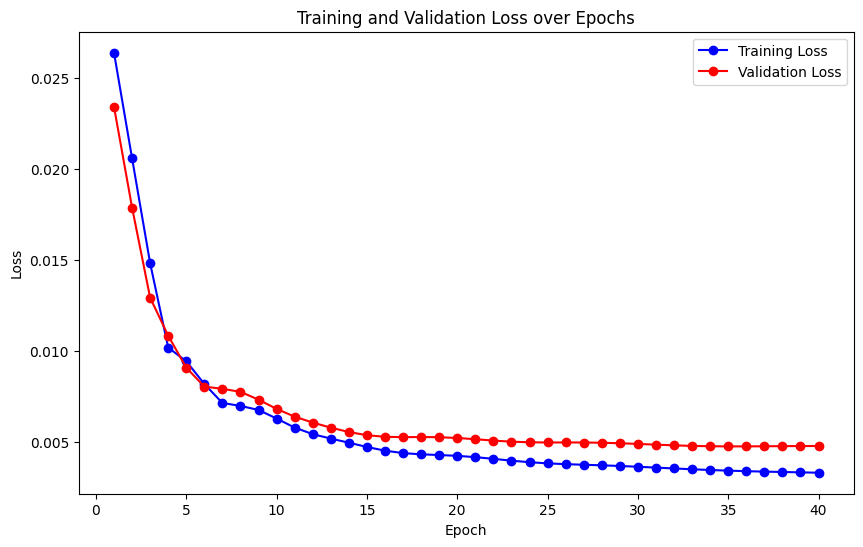

In [25]:
epochs = range(1, (stop_at_epoch + 1) if stop_at_epoch else (num_epochs + 1)) 

train_losses_scalar = [loss.item() for loss in train_losses]
val_losses_scalar = [loss.item() for loss in val_losses]

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(epochs, train_losses_scalar, 'bo-', label='Training Loss')
plt.plot(epochs, val_losses_scalar, 'ro-', label='Validation Loss')
plt.title('Training and Validation Loss over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

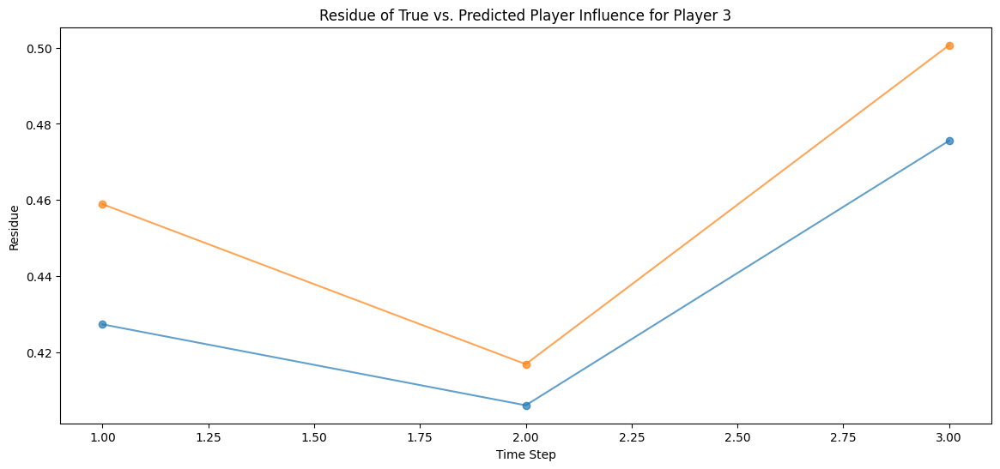

In [26]:
# # Define the start and end index of the samples you want to plot
example_index_start = 8  # Starting index of the range
example_index_end = 10  # Ending index of the range (exclusive)

# Select a player to visualize
player_selected = 3  # Indexing from 1 to 22
player_index = player_selected - 1  # Adjust for 0-based indexing

# Extracting true and predicted influences for the selected player across all time steps
true_influences_all_steps = y_test[example_index_start:example_index_end, :, player_index].detach().numpy()
predicted_influences_all_steps = test_outputs[example_index_start:example_index_end, :, player_index].detach().numpy()

# Calculating residue
residue = np.abs(true_influences_all_steps - predicted_influences_all_steps) / true_influences_all_steps

# Plotting residue for all three time steps
plt.figure(figsize=(14, 6))
time_steps = [0, 1, 2]  # Assuming 3 time steps in total

for frame in range(example_index_end - example_index_start):
    # Extract residues for the current frame
    frame_residue = residue[frame, :]
    
    # Adjusting x-axis to show sample index within the selected range
    time_steps_adjusted = np.arange(1, 4)
    
    plt.plot(time_steps_adjusted, frame_residue, label=f'Residue - Frame {frame + 1}', marker='o', linestyle='-', alpha=0.7)

plt.title(f'Residue of True vs. Predicted Player Influence for Player {player_index + 1}')
plt.xlabel('Time Step')
plt.ylabel('Residue')
# plt.legend()
plt.show()

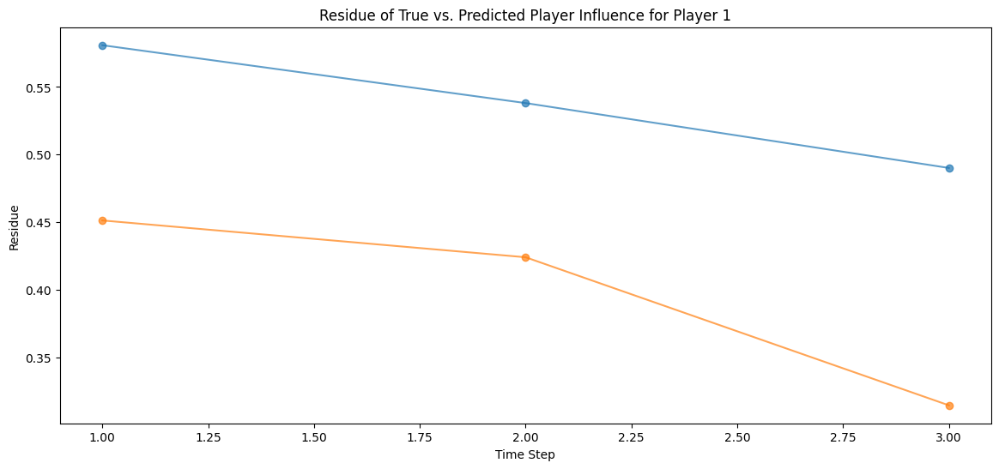

In [27]:
# # Define the start and end index of the samples you want to plot
# example_index_start = 8  # Starting index of the range
# example_index_end = 10  # Ending index of the range (exclusive)

# Select a player to visualize
player_selected = 1  # Indexing from 1 to 22
player_index = player_selected - 1  # Adjust for 0-based indexing

# Extracting true and predicted influences for the selected player across all time steps
true_influences_all_steps = y_test[example_index_start:example_index_end, :, player_index].detach().numpy()
predicted_influences_all_steps = test_outputs[example_index_start:example_index_end, :, player_index].detach().numpy()

# Calculating residue
residue = np.abs(true_influences_all_steps - predicted_influences_all_steps) / true_influences_all_steps

# Plotting residue for all three time steps
plt.figure(figsize=(14, 6))
time_steps = [0, 1, 2]  # Assuming 3 time steps in total

for frame in range(example_index_end - example_index_start):
    # Extract residues for the current frame
    frame_residue = residue[frame, :]
    
    # Adjusting x-axis to show sample index within the selected range
    time_steps_adjusted = np.arange(1, 4)
    
    plt.plot(time_steps_adjusted, frame_residue, label=f'Residue - Frame {frame + 1}', marker='o', linestyle='-', alpha=0.7)

plt.title(f'Residue of True vs. Predicted Player Influence for Player {player_index + 1}')
plt.xlabel('Time Step')
plt.ylabel('Residue')
# plt.legend()
plt.show()

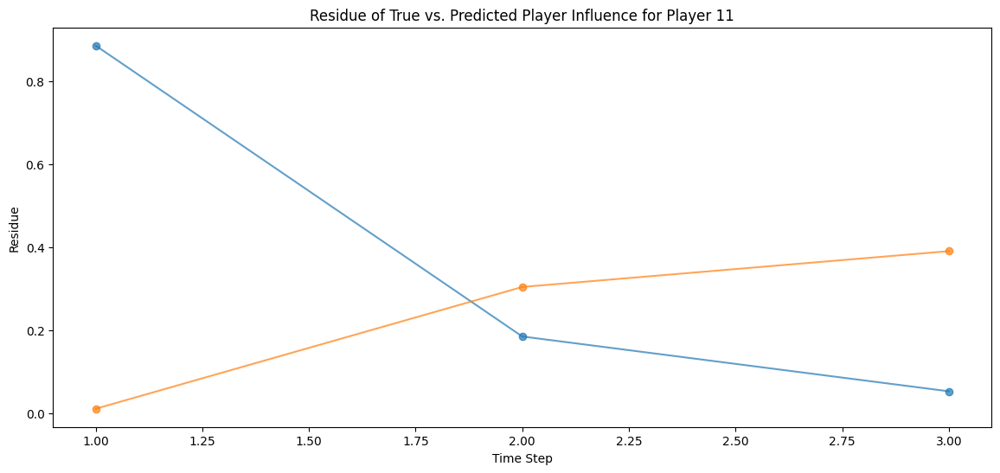

In [28]:
# # Define the start and end index of the samples you want to plot
# example_index_start = 8  # Starting index of the range
# example_index_end = 10  # Ending index of the range (exclusive)

# Select a player to visualize
player_selected = 11  # Indexing from 1 to 22
player_index = player_selected - 1  # Adjust for 0-based indexing

# Extracting true and predicted influences for the selected player across all time steps
true_influences_all_steps = y_test[example_index_start:example_index_end, :, player_index].detach().numpy()
predicted_influences_all_steps = test_outputs[example_index_start:example_index_end, :, player_index].detach().numpy()

# Calculating residue
residue = np.abs(true_influences_all_steps - predicted_influences_all_steps) / true_influences_all_steps

# Plotting residue for all three time steps
plt.figure(figsize=(14, 6))
time_steps = [0, 1, 2]  # Assuming 3 time steps in total

for frame in range(example_index_end - example_index_start):
    # Extract residues for the current frame
    frame_residue = residue[frame, :]
    
    # Adjusting x-axis to show sample index within the selected range
    time_steps_adjusted = np.arange(1, 4)
    
    plt.plot(time_steps_adjusted, frame_residue, label=f'Residue - Frame {frame + 1}', marker='o', linestyle='-', alpha=0.7)

plt.title(f'Residue of True vs. Predicted Player Influence for Player {player_index + 1}')
plt.xlabel('Time Step')
plt.ylabel('Residue')
# plt.legend()
plt.show()

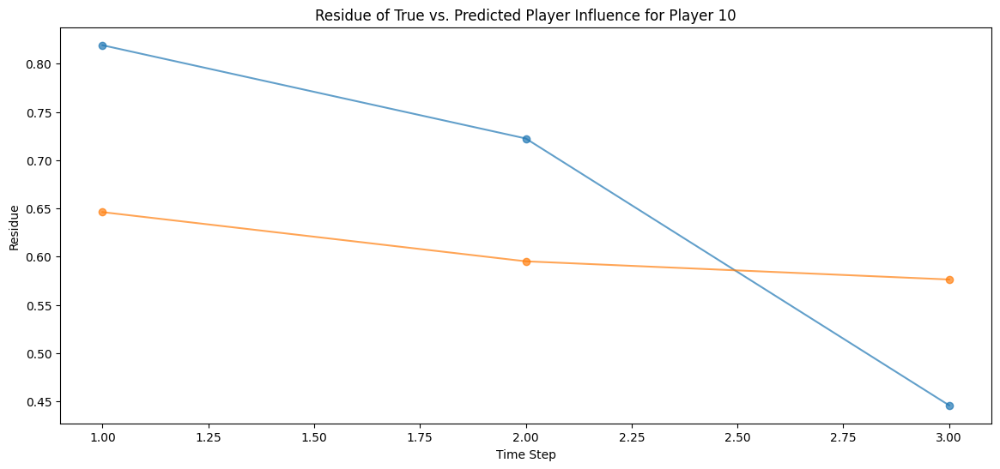

In [29]:
# # Define the start and end index of the samples you want to plot
# example_index_start = 8  # Starting index of the range
# example_index_end = 10  # Ending index of the range (exclusive)

# Select a player to visualize
player_selected = 10  # Indexing from 1 to 22
player_index = player_selected - 1  # Adjust for 0-based indexing

# Extracting true and predicted influences for the selected player across all time steps
true_influences_all_steps = y_test[example_index_start:example_index_end, :, player_index].detach().numpy()
predicted_influences_all_steps = test_outputs[example_index_start:example_index_end, :, player_index].detach().numpy()

# Calculating residue
residue = np.abs(true_influences_all_steps - predicted_influences_all_steps) / true_influences_all_steps

# Plotting residue for all three time steps
plt.figure(figsize=(14, 6))
time_steps = [0, 1, 2]  # Assuming 3 time steps in total

for frame in range(example_index_end - example_index_start):
    # Extract residues for the current frame
    frame_residue = residue[frame, :]
    
    # Adjusting x-axis to show sample index within the selected range
    time_steps_adjusted = np.arange(1, 4)
    
    plt.plot(time_steps_adjusted, frame_residue, label=f'Residue - Frame {frame + 1}', marker='o', linestyle='-', alpha=0.7)

plt.title(f'Residue of True vs. Predicted Player Influence for Player {player_index + 1}')
plt.xlabel('Time Step')
plt.ylabel('Residue')
# plt.legend()
plt.show()

In [30]:
n_train = int(0.8 * X.shape[0])
X_data, y_data = X[:n_train], X[n_train:]

print(y_data[1,:,0])
print(y_test[1,0,:])

[0.13548667 0.08627791 0.17645784 0.1493605  0.08259267 0.02297854
 0.05441145 0.01647518 0.06785172 0.03446781 0.06373293 0.51745068
 0.03880338 0.06785172 0.12508129 0.20680685 0.01105571 0.03685237
 0.0294819  0.0234121  0.04704097 0.17385649]
tensor([0.1071, 0.0822, 0.1548, 0.1385, 0.0856, 0.0273, 0.0587, 0.0176, 0.0653,
        0.0390, 0.0570, 0.5350, 0.0310, 0.1023, 0.1496, 0.1875, 0.0124, 0.0388,
        0.0325, 0.0150, 0.0479, 0.1827])


In [31]:
def plot_soccer_field():
    """Plot a soccer field of dimensions 105x68."""
    fig = plt.figure(figsize=(10.5, 6.8))  # Field size in aspect ratio 105x68
    ax = fig.add_subplot(1, 1, 1)

    # Soccer field dimensions
    plt.xlim(0, 105)
    plt.ylim(0, 68)

    # Add center line and center circle
    plt.plot([52.5, 52.5], [0, 68], color="black")
    center_circle = plt.Circle((52.5, 34), 9.15, color="black", fill=False)
    ax.add_patch(center_circle)

    # Add penalty areas
    penalty_area1 = patches.Rectangle((0, 20.15), 16.5, 27.7, linewidth=1, edgecolor='black', facecolor='none')
    penalty_area2 = patches.Rectangle((88.5, 20.15), 16.5, 27.7, linewidth=1, edgecolor='black', facecolor='none')
    ax.add_patch(penalty_area1)
    ax.add_patch(penalty_area2)

    return ax

# Label_points function to include residue values
def label_points_with_residue(x, y, residues, ax):
    for i in range(len(x)):
        residue_label = f"{i+1} ({residues[i].item():.2f})"
        ax.text(x[i], y[i], residue_label, fontsize=8, ha='right', va='bottom')

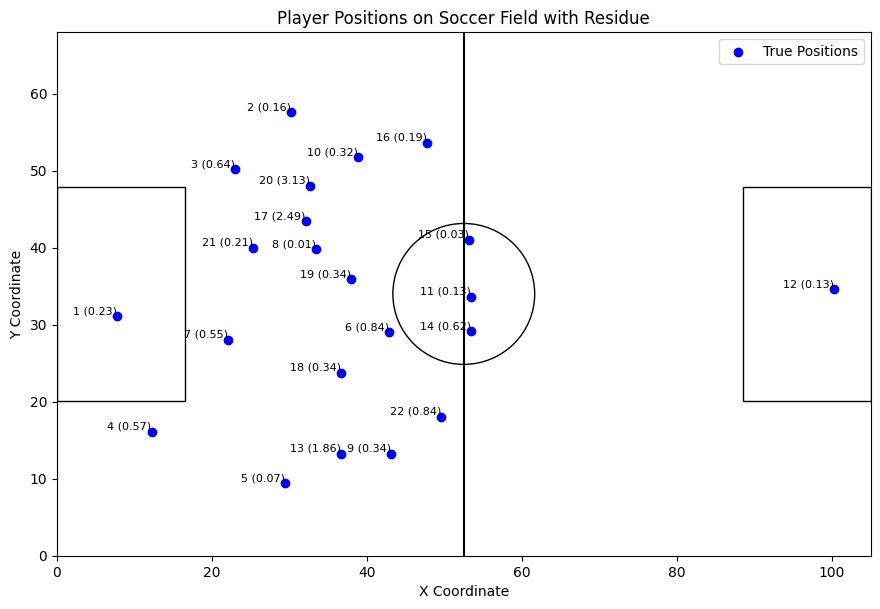

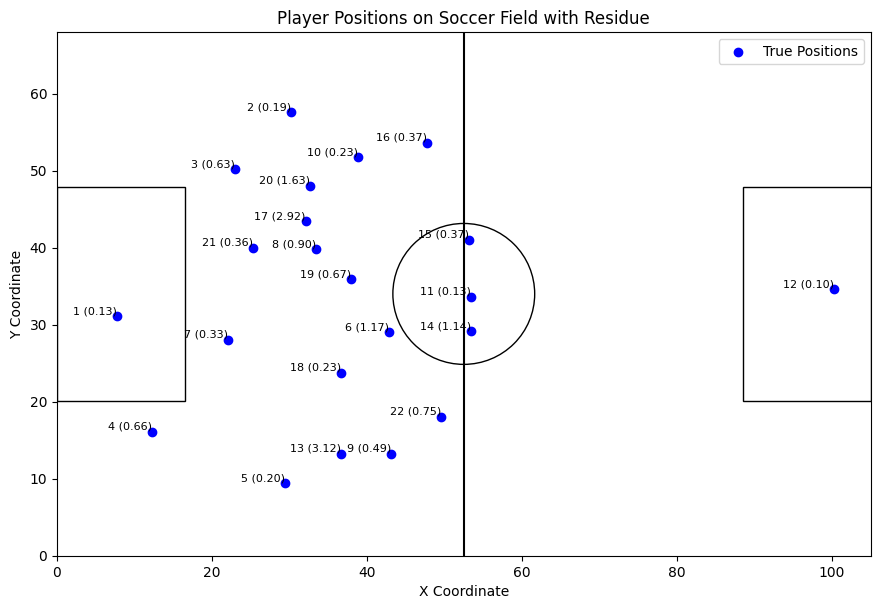

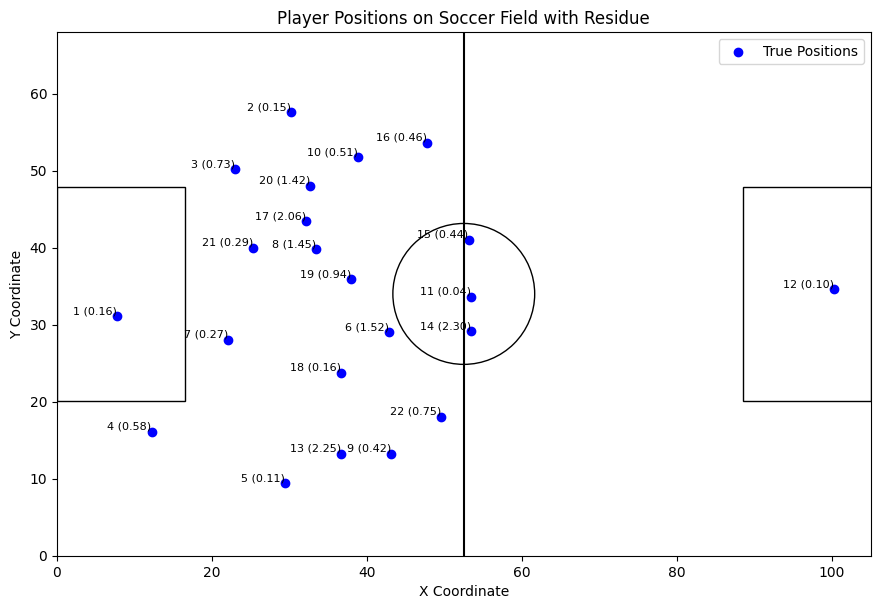

In [32]:
time_frame = 0

for time_step in [0, 1, 2]:

    # Coordinates
    true_x = y_data[time_frame,:,1]
    true_y = y_data[time_frame,:,2]

    true_inf = y_test[time_frame, time_step, :]
    pred_inf = test_outputs[time_frame, time_step, :]

    # Calculate residue values (simple absolute difference for demonstration)
    residues = np.abs(true_inf - pred_inf)/true_inf

    # Now use the modified function in your plot
    ax = plot_soccer_field()

    # Plot true positions with labels and residues
    ax.scatter(true_x, true_y, color='blue', label='True Positions', marker='o')
    label_points_with_residue(true_x, true_y, residues, ax)  # Use residue_x or residue_y as needed

    ax.set_xlabel('X Coordinate')
    ax.set_ylabel('Y Coordinate')
    ax.set_title('Player Positions on Soccer Field with Residue')
    ax.legend()
    plt.show()

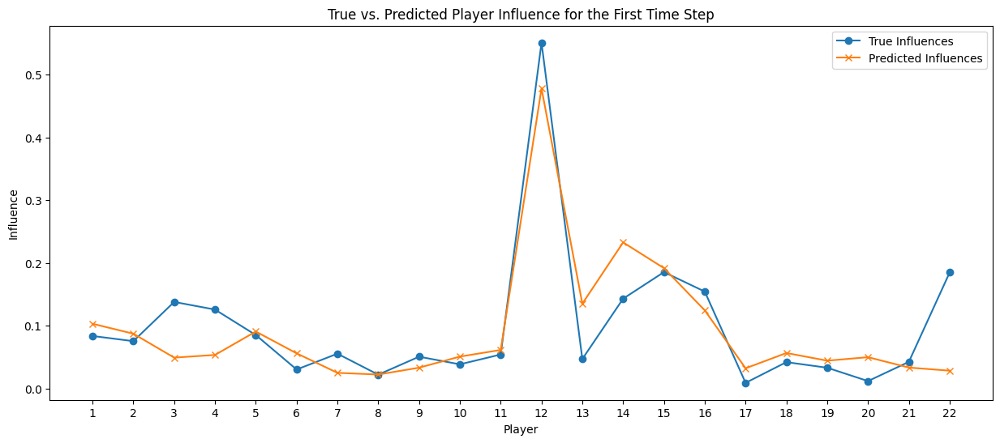

In [33]:
# Assuming the shapes of y_test and test_outputs are [samples, time_steps, players]
# and you're interested in plotting the first time step of the first sample
time_frame = 0

# Extracting true and predicted influences for the first time step
true_influences = y_test[time_frame, 0, :].detach().numpy()
predicted_influences = test_outputs[time_frame, 0, :].detach().numpy()

# Number of players
n_players = true_influences.shape[0]

# Plotting
plt.figure(figsize=(15, 6))
plt.plot(np.arange(1, n_players + 1), true_influences, 'o-', label='True Influences')
plt.plot(np.arange(1, n_players + 1), predicted_influences, 'x-', label='Predicted Influences')
plt.xlabel('Player')
plt.ylabel('Influence')
plt.title(f"True vs. Predicted Player Influence for the First Time Step")
plt.xticks(np.arange(1, n_players + 1))
plt.legend()
plt.show()

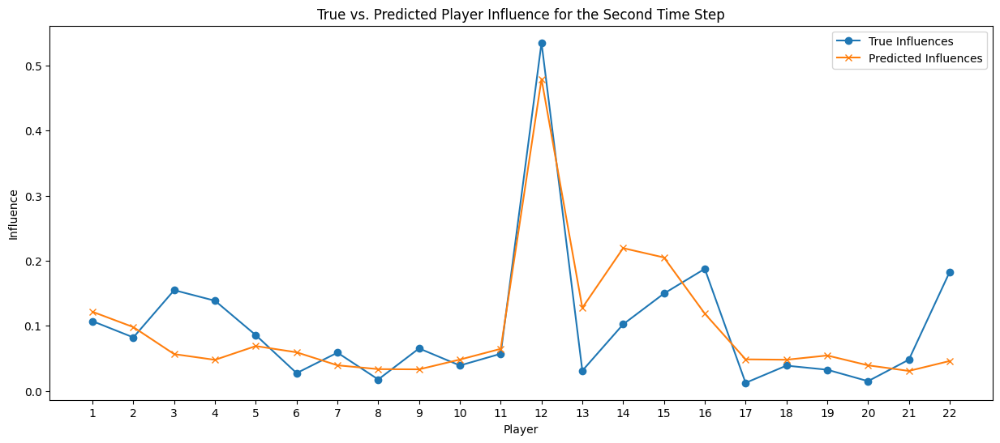

In [34]:
# Assuming the shapes of y_test and test_outputs are [samples, time_steps, players]
# and you're interested in plotting the first time step of the first sample
time_frame = 0

# Extracting true and predicted influences for the first time step
true_influences = y_test[time_frame, 1, :].detach().numpy()
predicted_influences = test_outputs[time_frame, 1, :].detach().numpy()

# Number of players
n_players = true_influences.shape[0]

# Plotting
plt.figure(figsize=(15, 6))
plt.plot(np.arange(1, n_players + 1), true_influences, 'o-', label='True Influences')
plt.plot(np.arange(1, n_players + 1), predicted_influences, 'x-', label='Predicted Influences')
plt.xlabel('Player')
plt.ylabel('Influence')
plt.title(f"True vs. Predicted Player Influence for the Second Time Step")
plt.xticks(np.arange(1, n_players + 1))
plt.legend()
plt.show()

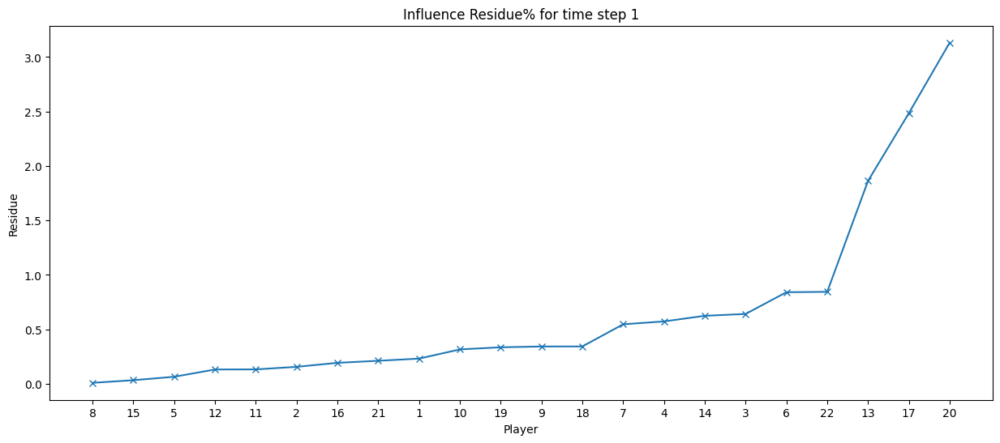

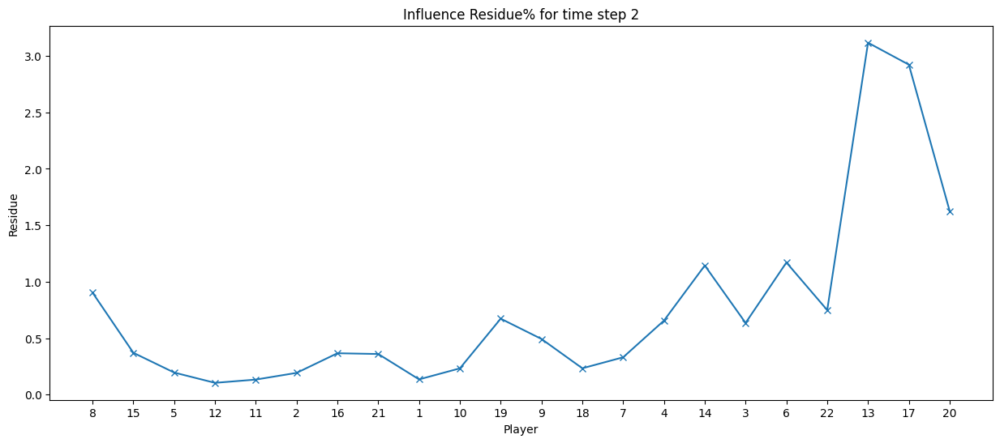

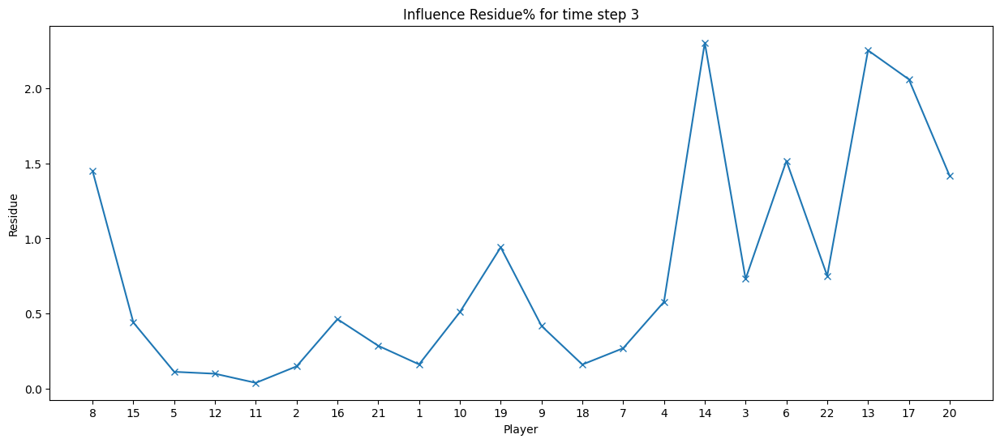

In [36]:
# Extracting true and predicted influences for the first time step
true_influences = y_test[time_frame, 0, :].detach().numpy()
predicted_influences = test_outputs[time_frame, 0, :].detach().numpy()
residue = np.abs(true_influences - predicted_influences) / true_influences

sorted_indices = np.argsort(residue)  # Get sorted indices

for time_step in [0, 1, 2]:
    true_influences = y_test[time_frame, time_step, :].detach().numpy()
    plt.figure(figsize=(15, 6))

    # Extracting true and predicted influences for the first time step
    true_influences = y_test[time_frame, time_step, :].detach().numpy()
    predicted_influences = test_outputs[time_frame, time_step, :].detach().numpy()
    residue = np.abs(true_influences - predicted_influences) / true_influences
            
    reordered_residue = residue[sorted_indices]

    # Number of players
    n_players = true_influences.shape[0]

    # Plotting
    plt.plot(np.arange(1, n_players + 1), reordered_residue, 'x-')

    plt.title('Influence Residue% for time step ' + str(time_step+1))
    plt.xlabel('Player')
    plt.ylabel('Residue')
    plt.xticks(np.arange(1, len(sorted_indices) + 1), labels=sorted_indices+1)    
#     plt.yticks(np.arange(1, 50))
#     plt.legend()
    plt.show()

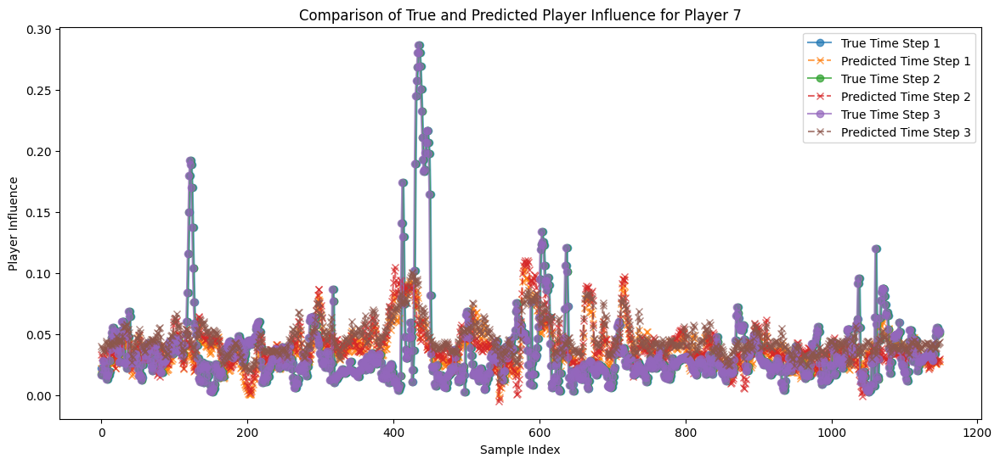

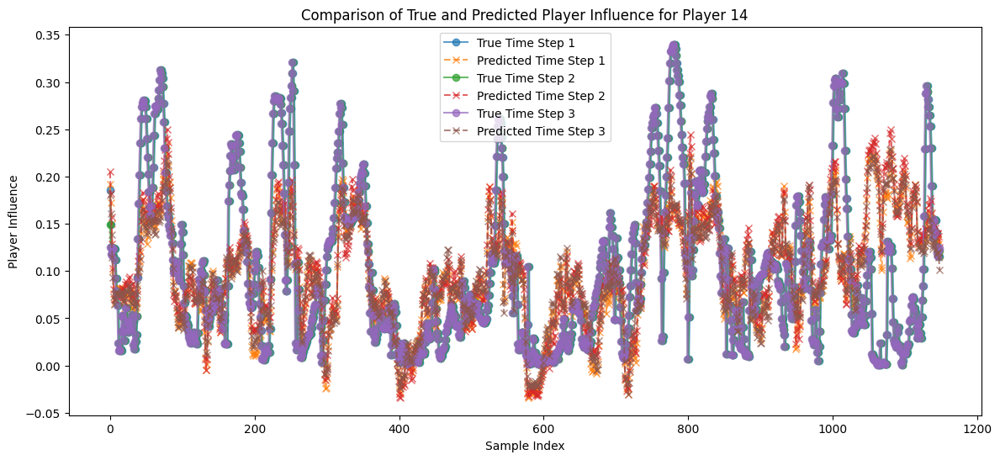

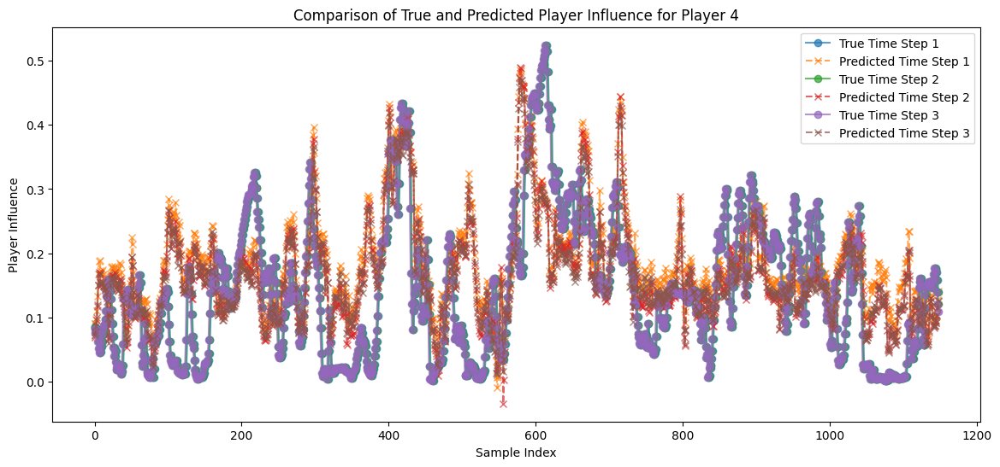

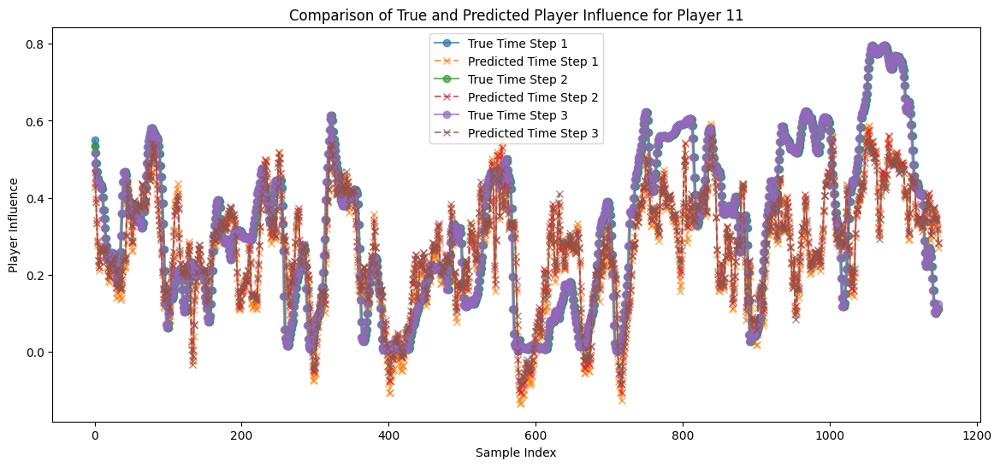

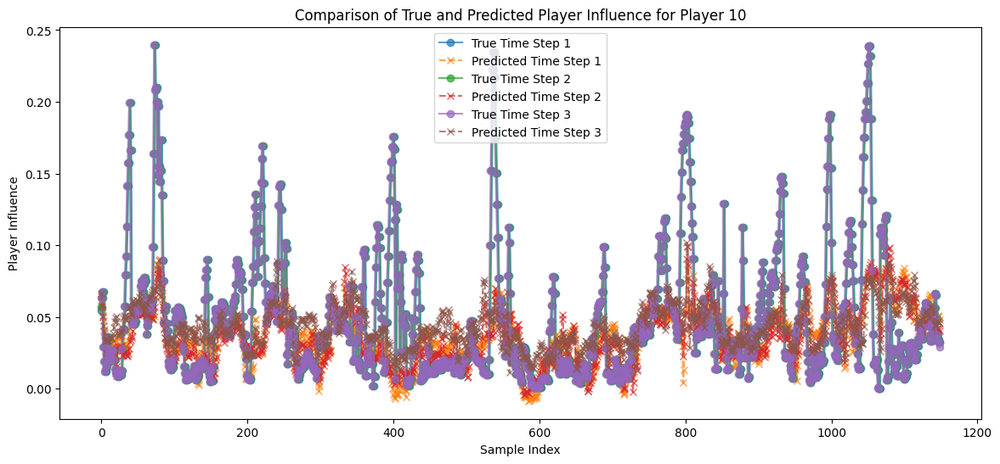

...

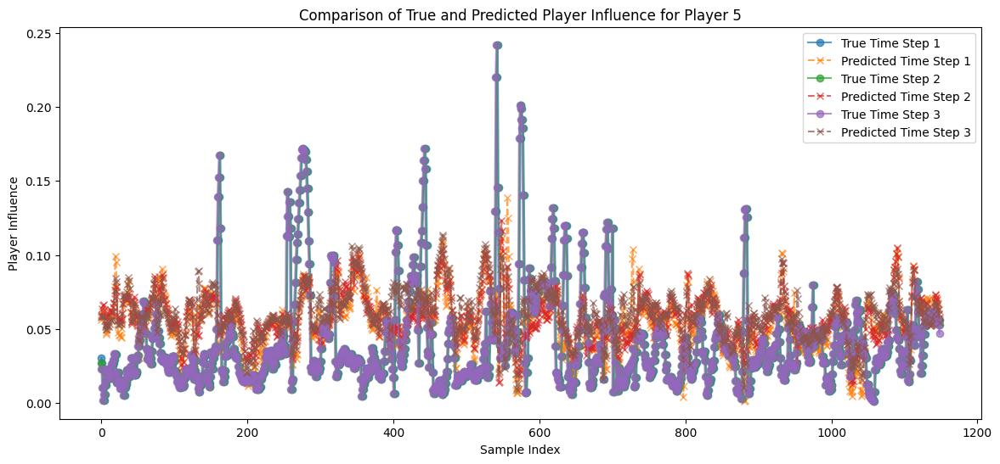

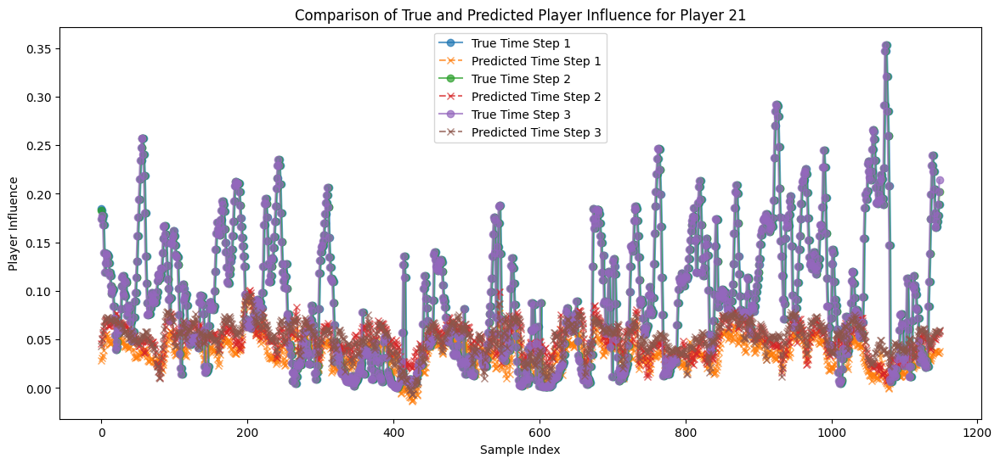

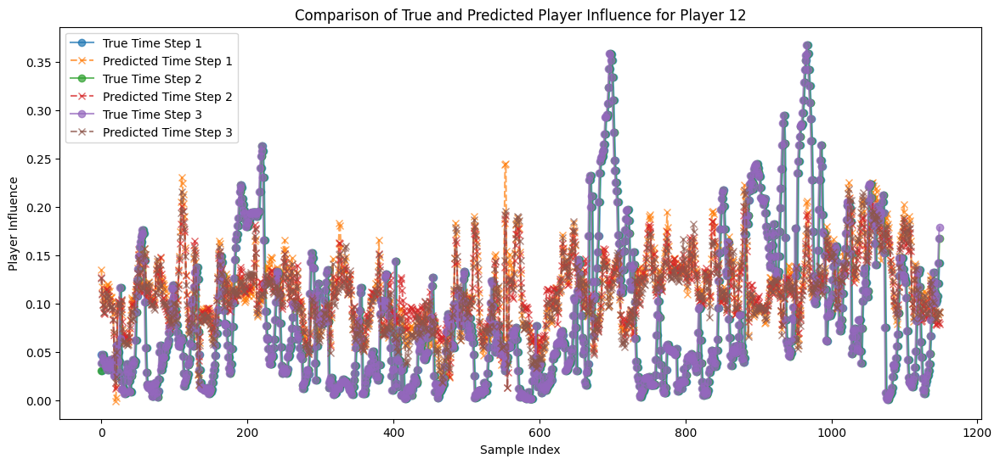

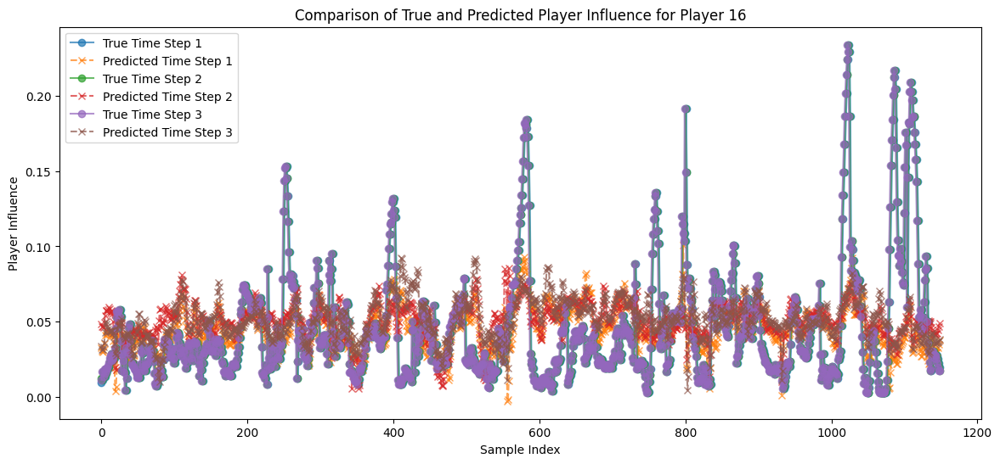

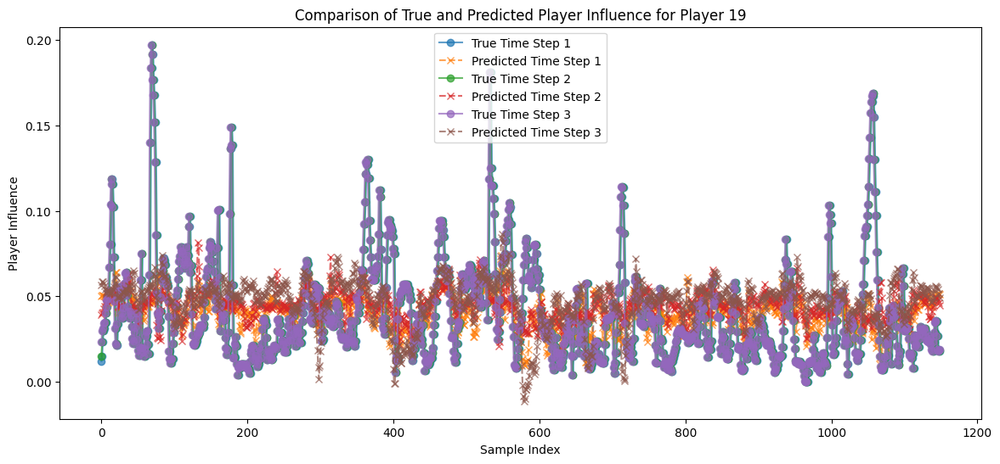

In [42]:
interested_players = sorted_indices

for player_selected in interested_players:
    player_index = player_selected # - 1  # Adjust for 0-based indexing

    # Number of samples
    num_samples = y_test.shape[0]

    # Extract true and predicted influences for the selected player
    true_influences = y_test[:, :, player_index].detach().numpy()
    predicted_influences = test_outputs[:, :, player_index].detach().numpy()

    # Plotting
    plt.figure(figsize=(14, 6))

    # Assuming 3 time steps
    time_steps = ['Time Step 1', 'Time Step 2', 'Time Step 3']
    for i in range(3):
        # Plot true values
        plt.plot(np.arange(num_samples), true_influences[:, i], label=f'True {time_steps[i]}', marker='o', linestyle='-', alpha=0.7)
        # Plot predicted values
        plt.plot(np.arange(num_samples), predicted_influences[:, i], label=f'Predicted {time_steps[i]}', marker='x', linestyle='--', alpha=0.7)

    plt.xlabel('Sample Index')
    plt.ylabel('Player Influence')
    plt.title(f'Comparison of True and Predicted Player Influence for Player {player_selected}')
    plt.legend()
    plt.show()

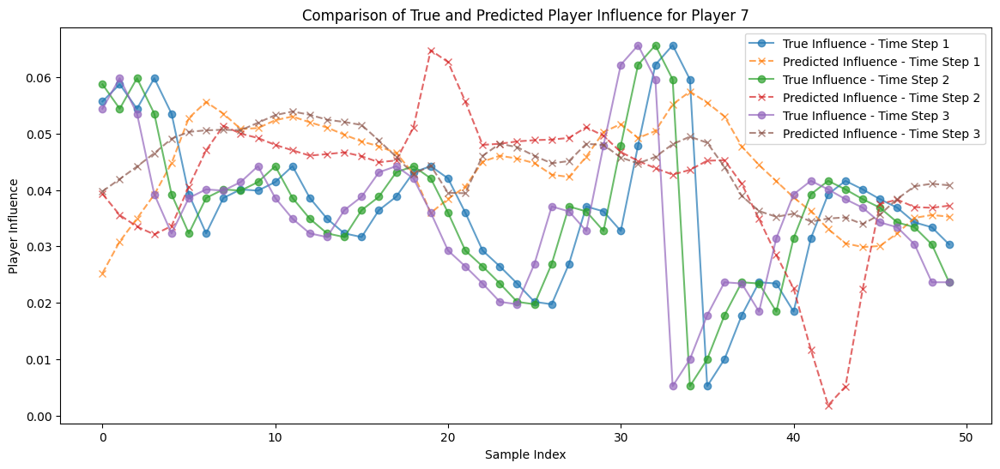

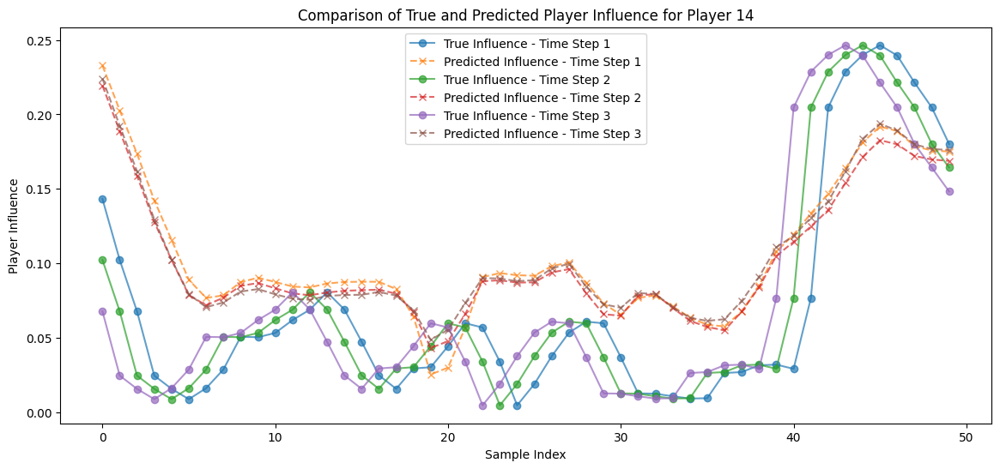

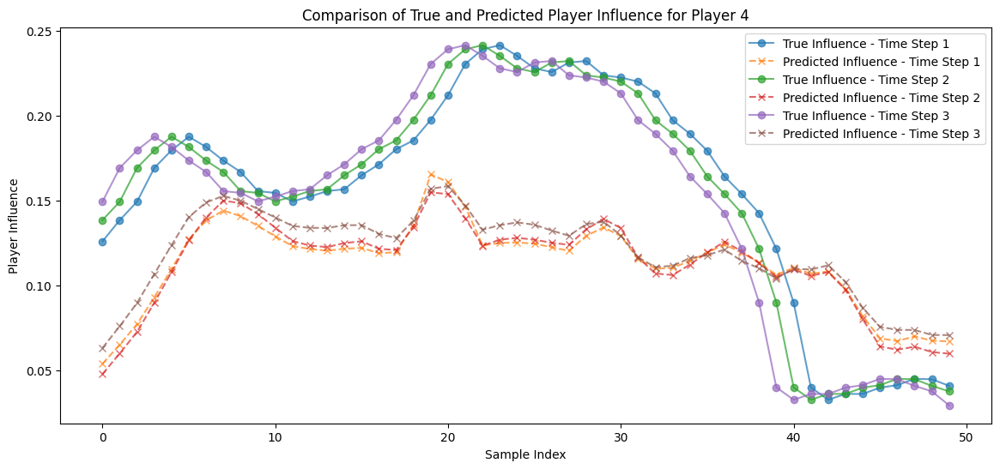

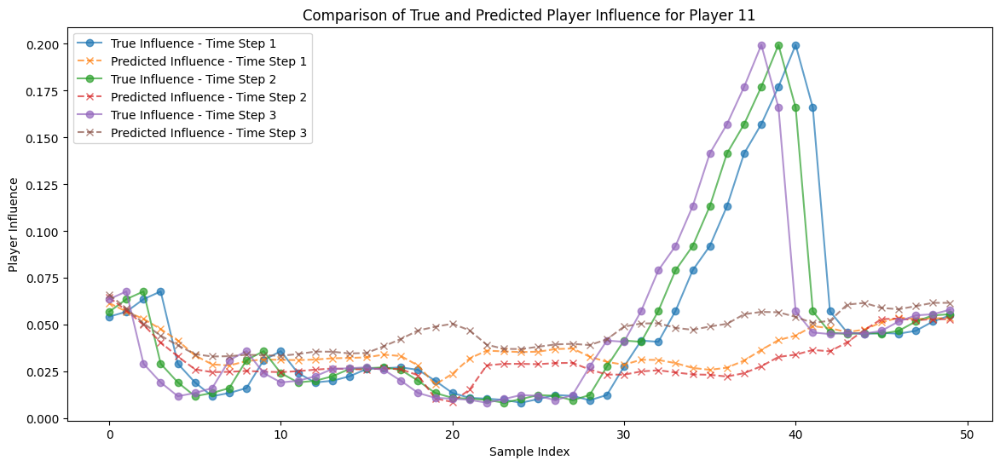

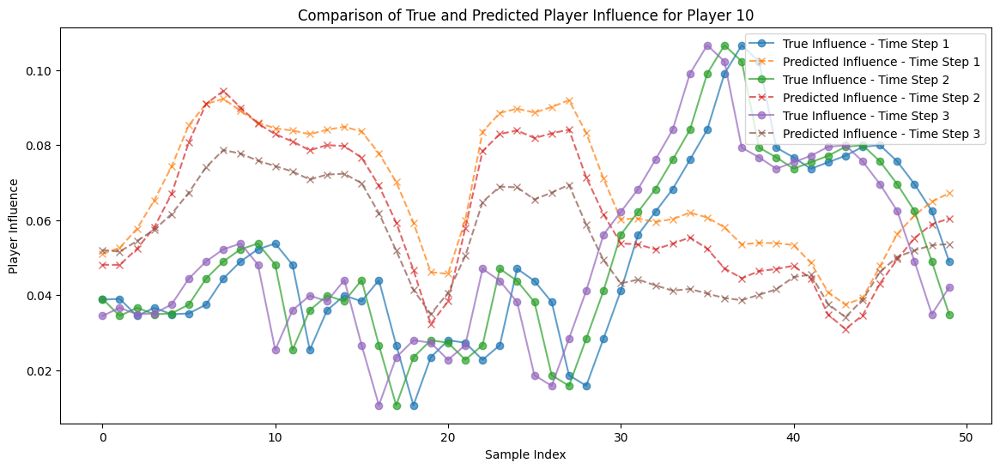

...

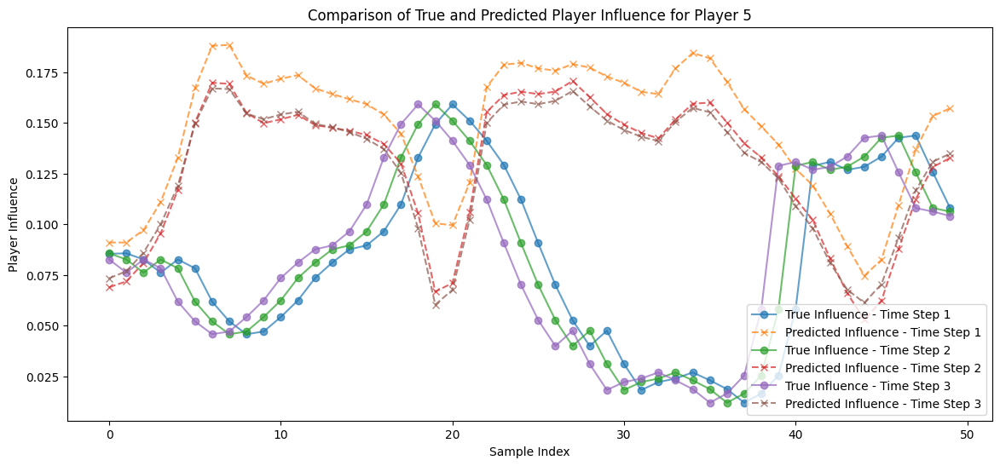

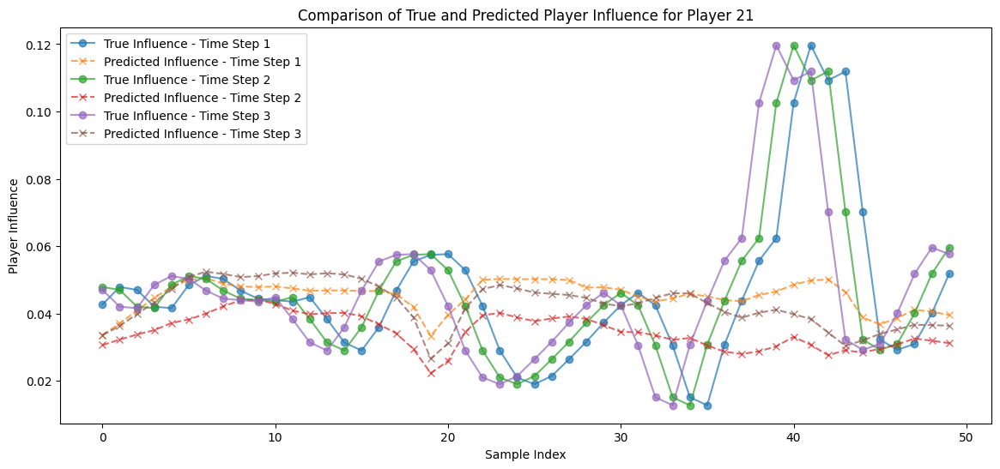

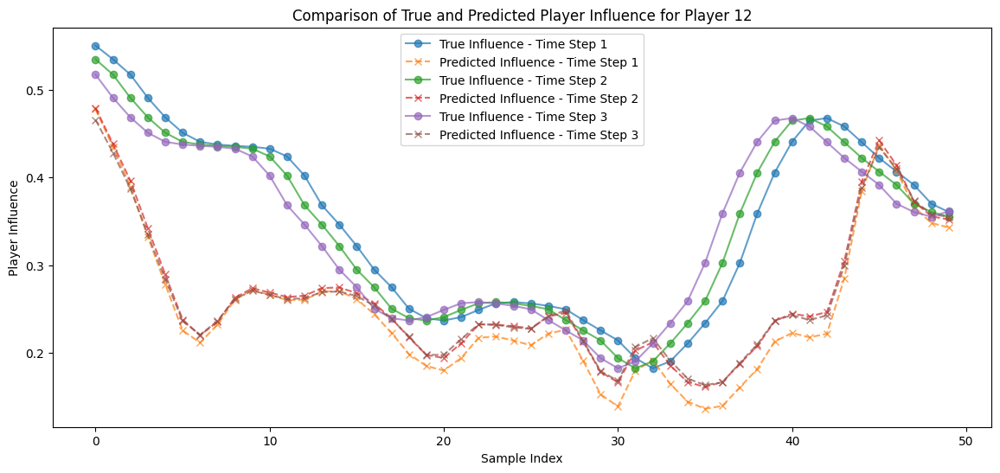

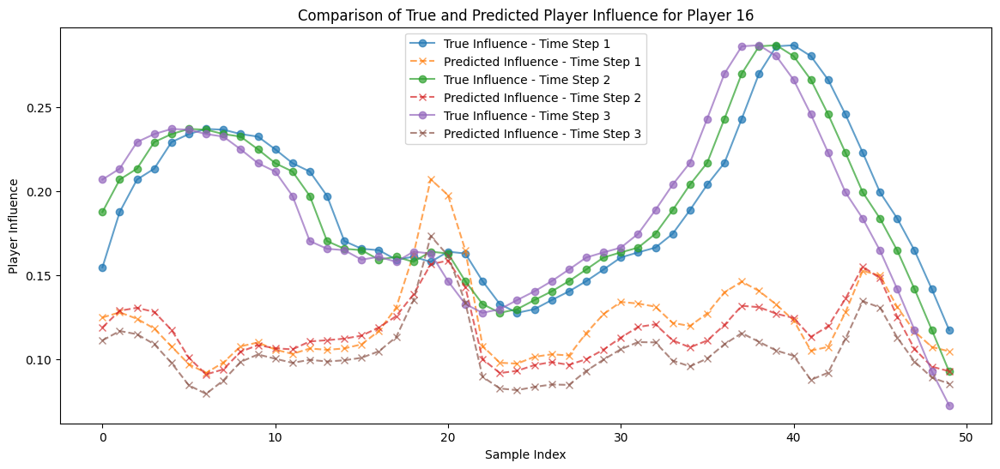

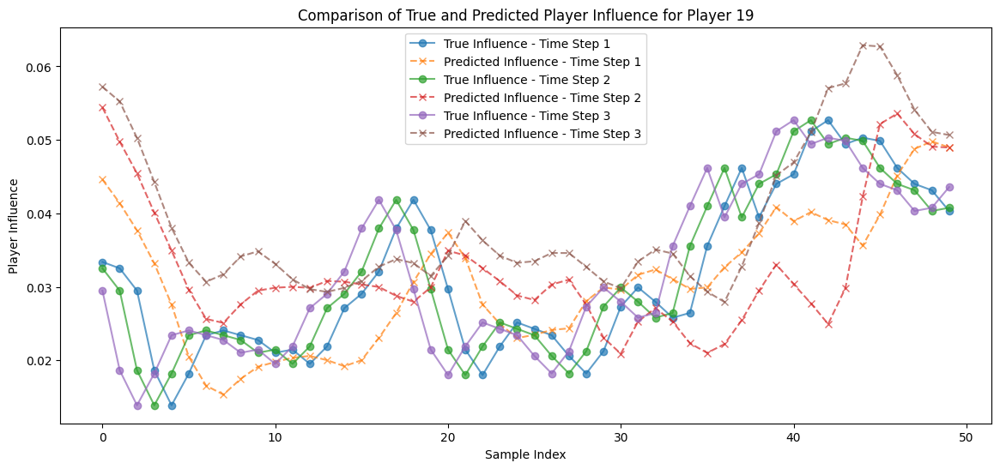

In [43]:
for player_selected in interested_players:
    # Define the start and end index of the samples you want to plot
    example_index_start = 0  # Starting index of the range
    example_index_end = 50  # Ending index of the range (exclusive)

    # Select a player to visualize
    player_index = player_selected - 1  # Adjust for 0-based indexing

    # Extracting true and predicted influences for the selected player across all time steps
    true_influences_all_steps = y_test[example_index_start:example_index_end, :, player_index].detach().numpy()
    predicted_influences_all_steps = test_outputs[example_index_start:example_index_end, :, player_index].detach().numpy()

    # Plotting for all three time steps
    plt.figure(figsize=(14, 6))
    time_steps = [0, 1, 2]  # Assuming 3 time steps in total

    for time_step in time_steps:
        # Extract influences for the current time step
        true_influences = true_influences_all_steps[:, time_step]
        predicted_influences = predicted_influences_all_steps[:, time_step]

        # Adjusting x-axis to show sample index within the selected range
        sample_indexes = np.arange(example_index_start, example_index_end)

        plt.plot(sample_indexes, true_influences, label=f'True Influence - Time Step {time_step + 1}', marker='o', linestyle='-', alpha=0.7)
        plt.plot(sample_indexes, predicted_influences, label=f'Predicted Influence - Time Step {time_step + 1}', marker='x', linestyle='--', alpha=0.7)

    plt.title(f'Comparison of True and Predicted Player Influence for Player {player_index + 1}')
    plt.xlabel('Sample Index')
    plt.ylabel('Player Influence')
    plt.legend()
    plt.show()

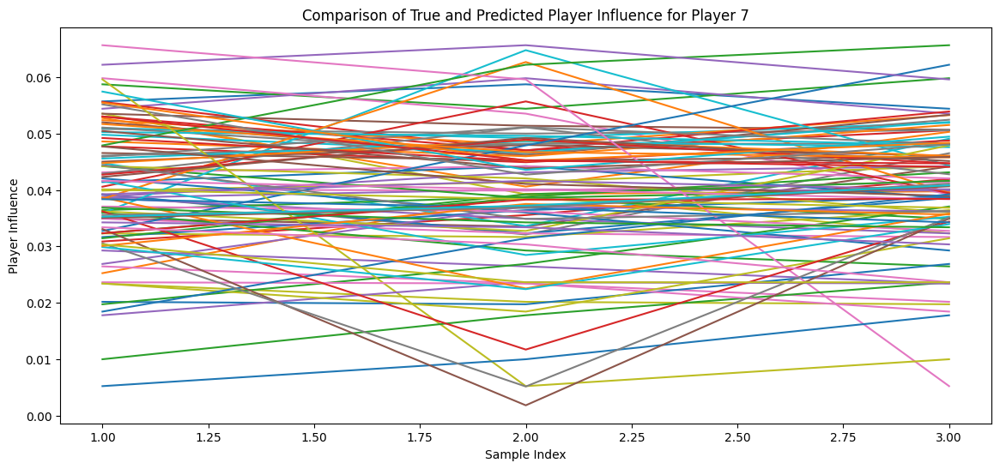

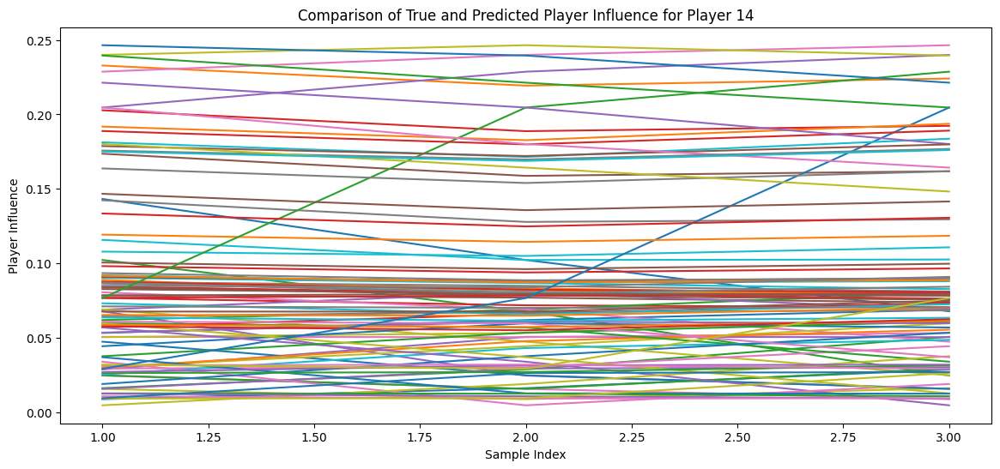

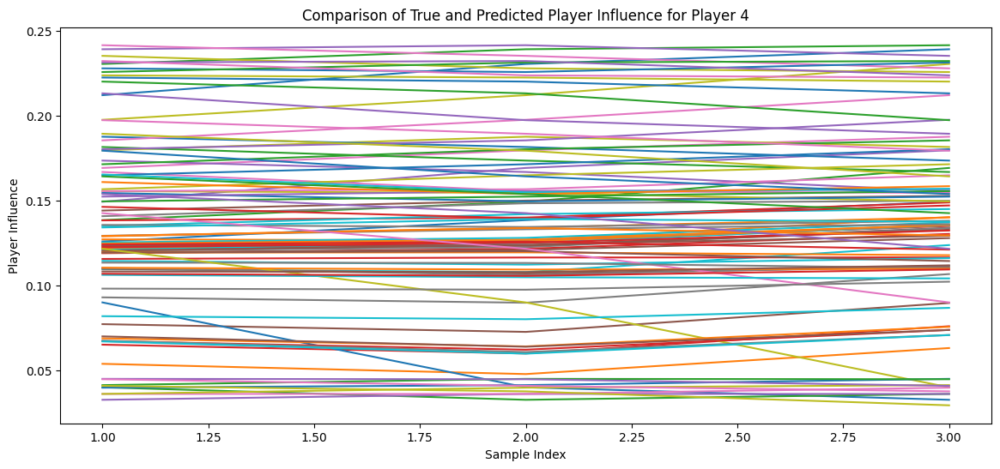

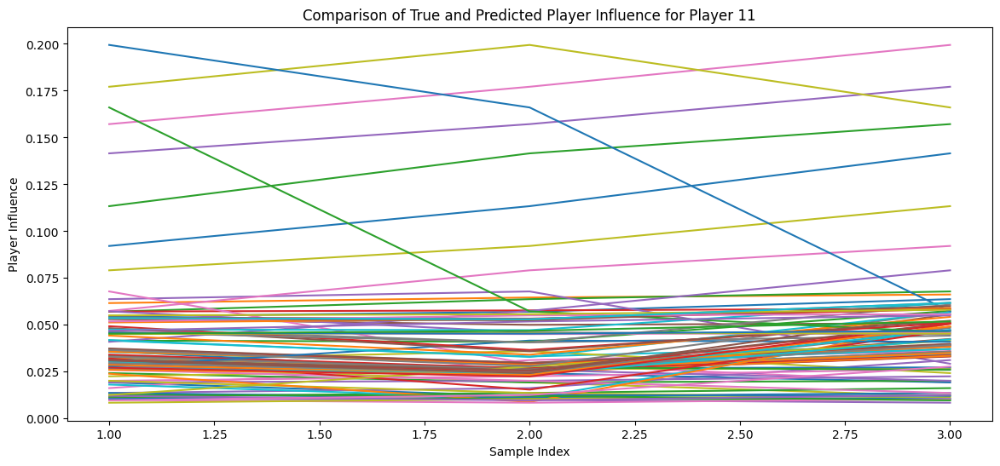

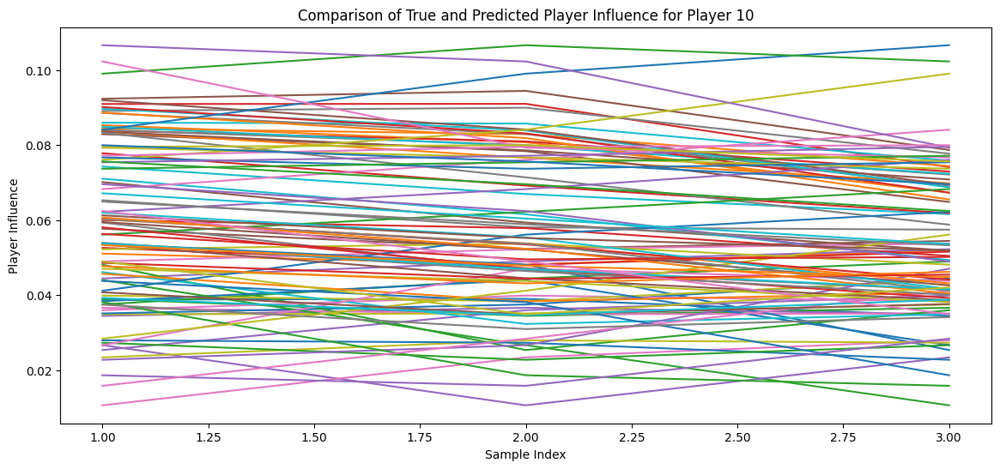

...

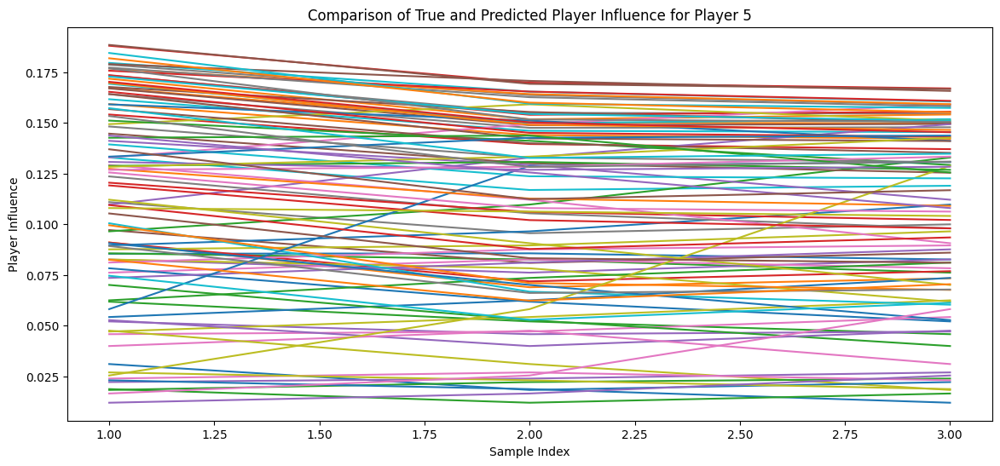

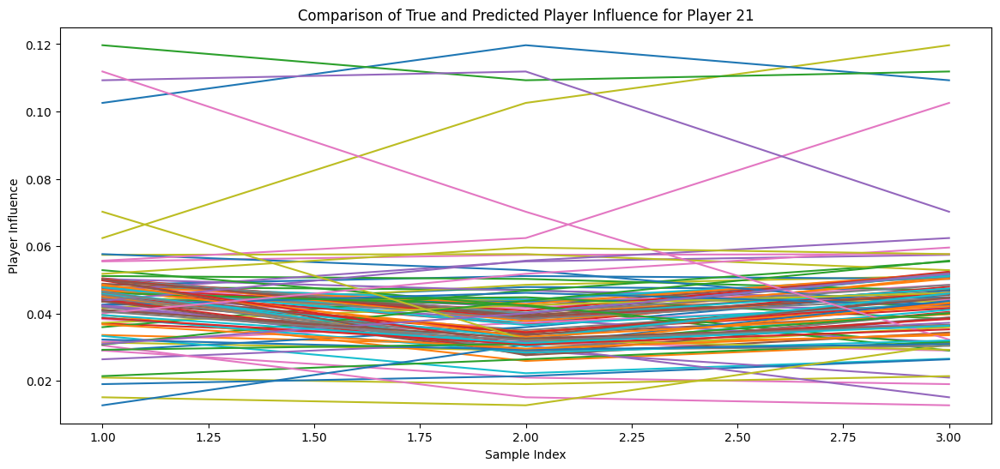

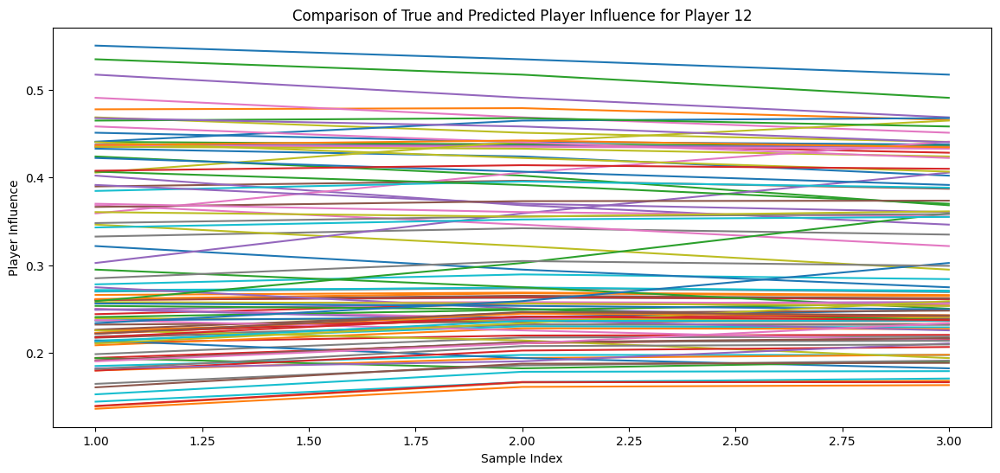

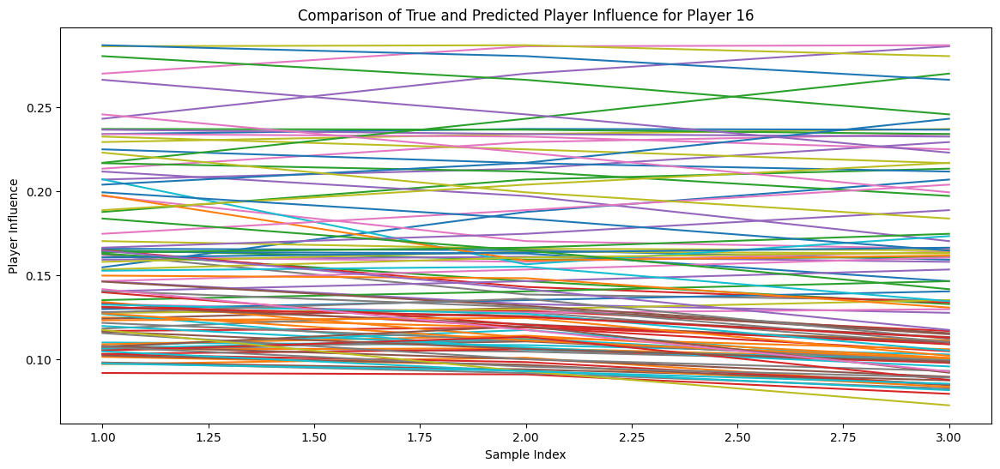

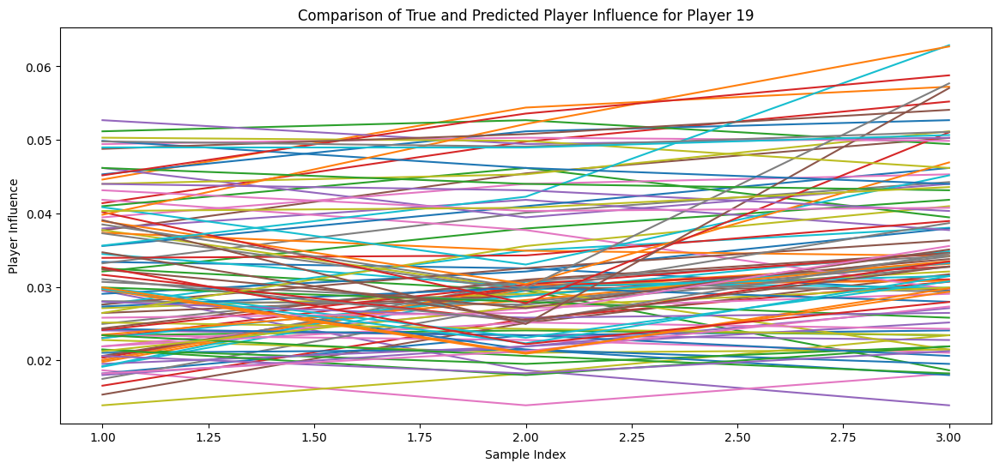

In [44]:
for player_selected in interested_players:
    # Define the start and end index of the samples you want to plot
    example_index_start = 0  # Starting index of the range
    example_index_end = 50  # Ending index of the range (exclusive)

    # Select a player to visualize
    player_index = player_selected - 1  # Adjust for 0-based indexing

    # Extracting true and predicted influences for the selected player across all time steps
    true_influences_all_steps = y_test[example_index_start:example_index_end, :, player_index].detach().numpy()
    predicted_influences_all_steps = test_outputs[example_index_start:example_index_end, :, player_index].detach().numpy()

    # Plotting for all three time steps
    plt.figure(figsize=(14, 6))
    time_steps = [0, 1, 2]  # Assuming 3 time steps in total

    for frame in range(example_index_end-example_index_start):
        # Extract influences for the current time step
        true_influences = true_influences_all_steps[frame, :]
        predicted_influences = predicted_influences_all_steps[frame, :]

        # Adjusting x-axis to show sample index within the selected range
        time_steps = np.arange(1, 4)

        plt.plot(time_steps, true_influences, label=f'True Influence - Frame {frame + 1}')#, marker='o', linestyle='-', alpha=0.7)
        plt.plot(time_steps, predicted_influences, label=f'Predicted Influence - Frame {frame + 1}')#, marker='x', linestyle='--', alpha=0.7)

    plt.title(f'Comparison of True and Predicted Player Influence for Player {player_index + 1}')
    plt.xlabel('Sample Index')
    plt.ylabel('Player Influence')
    # plt.legend()
    plt.show()

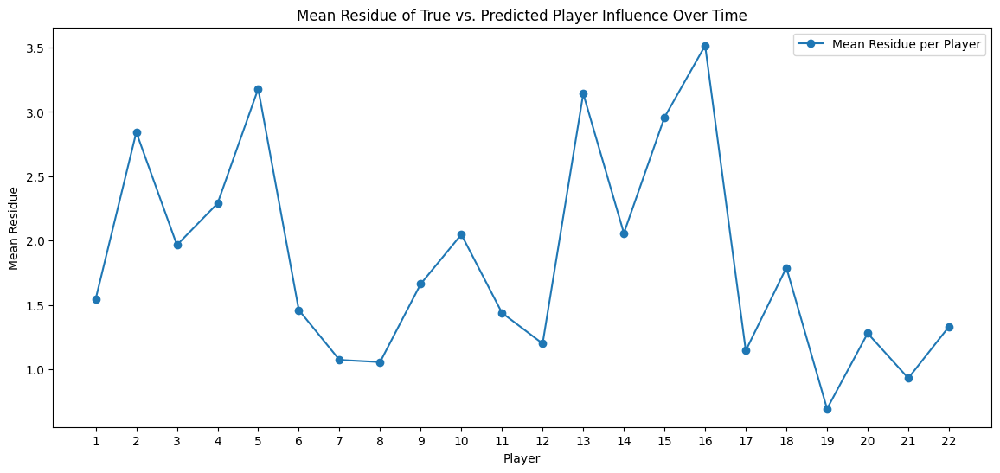

In [45]:
# Calculate residue for each player over time
def calculate_residue(true_influences, predicted_influences, epsilon=1e-10):
    # Ensure the shapes of the true and predicted influences are the same
    assert true_influences.shape == predicted_influences.shape, "Shapes of true and predicted influences must match."
    
    # Calculate the residue, adding epsilon to avoid division by zero
    residue = np.abs(true_influences - predicted_influences) / (true_influences + epsilon)
    
    # Set residue to zero where true influences are zero
    residue[true_influences == 0] = 0
    
    return residue

# Extracting true and predicted influences for all samples and players
true_influences_all_samples = y_test.detach().numpy()
predicted_influences_all_samples = test_outputs.detach().numpy()

# Calculate the residue for all players and time steps
residue_all_samples = calculate_residue(true_influences_all_samples, predicted_influences_all_samples)

# Calculate the mean residue over time for each player
mean_residue_per_player = np.mean(residue_all_samples, axis=(0, 1))

# Plotting the mean residue for each player
plt.figure(figsize=(14, 6))
players = np.arange(1, mean_residue_per_player.shape[0] + 1)
plt.plot(players, mean_residue_per_player, 'o-', label='Mean Residue per Player')
plt.xlabel('Player')
plt.ylabel('Mean Residue')
plt.title('Mean Residue of True vs. Predicted Player Influence Over Time')
plt.xticks(players)
plt.legend()
plt.show()

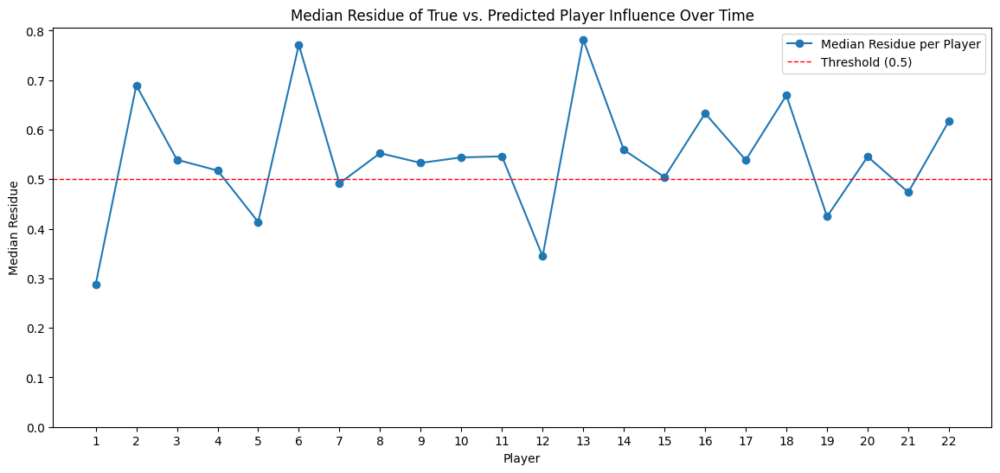

In [46]:
# Extracting true and predicted influences for all samples and players
true_influences_all_samples = y_test.detach().numpy()
predicted_influences_all_samples = test_outputs.detach().numpy()

# Calculate the residue for all players and time steps
residue_all_samples = calculate_residue(true_influences_all_samples, predicted_influences_all_samples)

# Calculate the median residue over time for each player
median_residue_per_player = np.median(residue_all_samples, axis=(0, 1))

# Plotting the median residue for each player
plt.figure(figsize=(14, 6))
players = np.arange(1, median_residue_per_player.shape[0] + 1)
plt.plot(players, median_residue_per_player, 'o-', label='Median Residue per Player')
plt.xlabel('Player')
plt.ylabel('Median Residue')
plt.title('Median Residue of True vs. Predicted Player Influence Over Time')
plt.xticks(players)
plt.yticks(np.arange(0, np.max(median_residue_per_player) + 0.1, 0.1))  # Set y-ticks at 0.1 intervals
plt.axhline(y=0.5, color='r', linestyle='--', linewidth=1, label='Threshold (0.5)')
plt.legend()
plt.show()

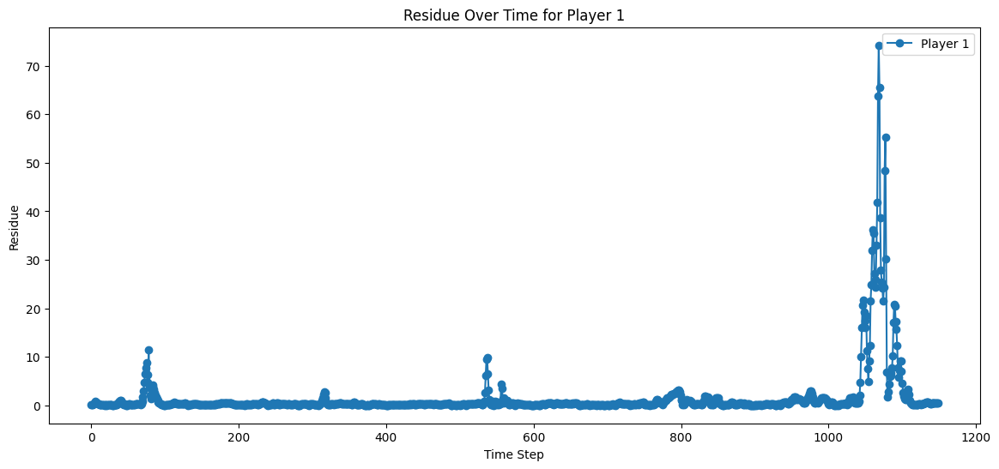

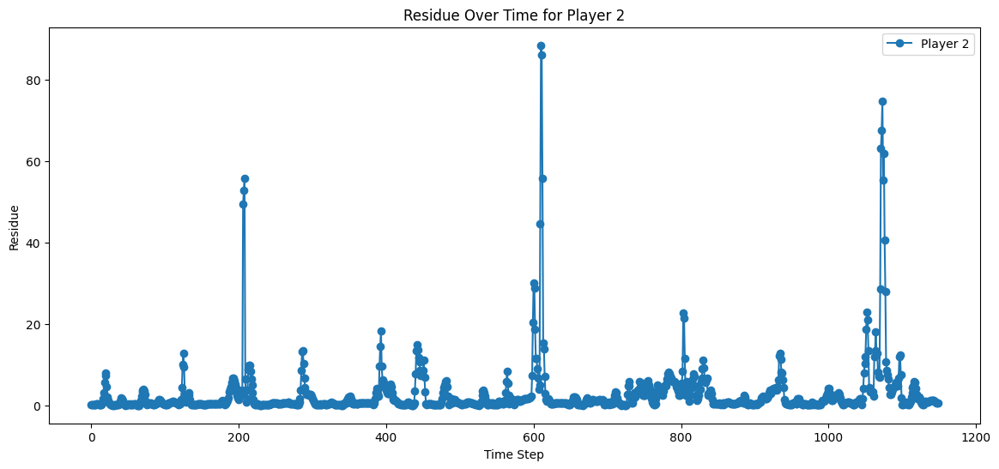

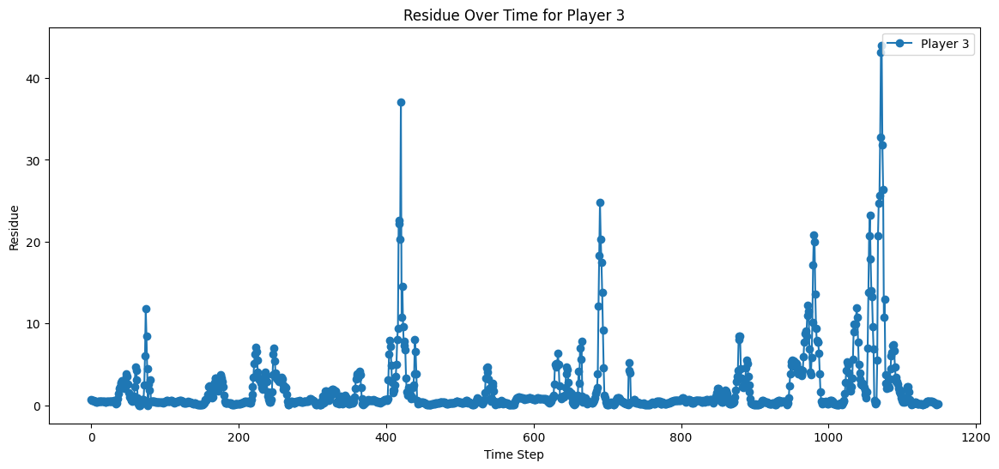

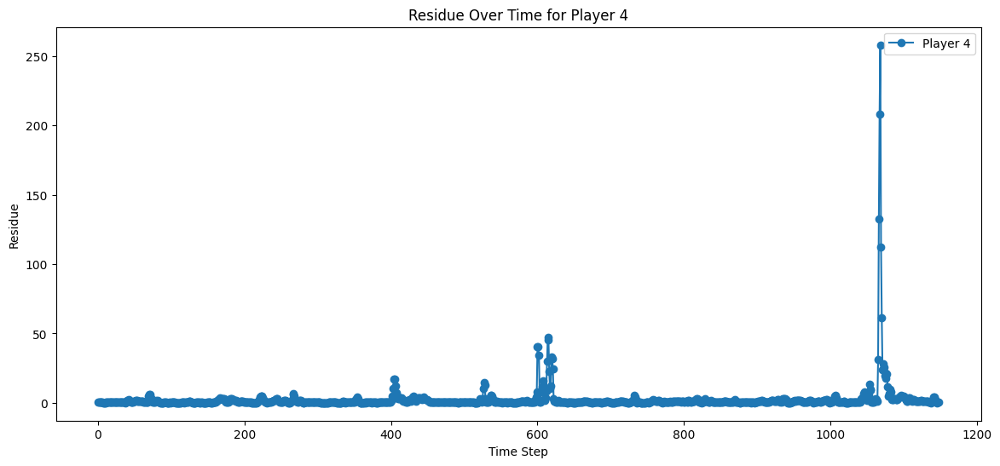

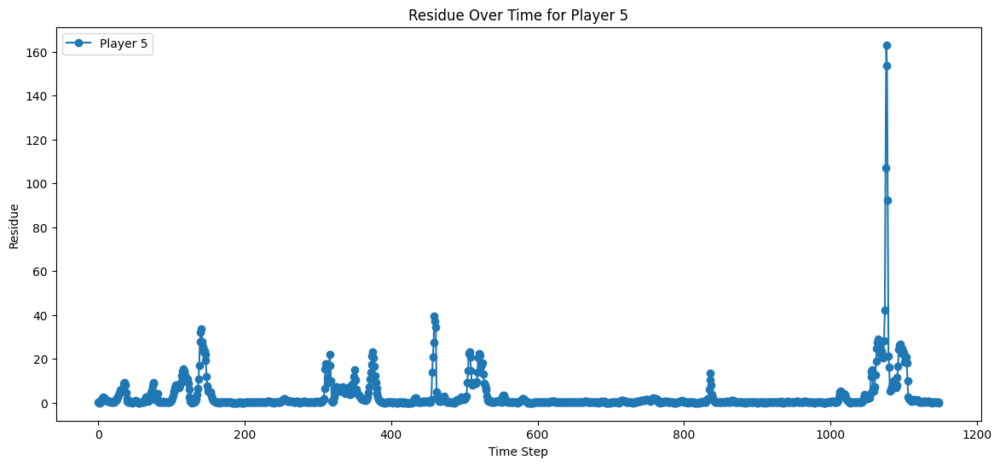

...

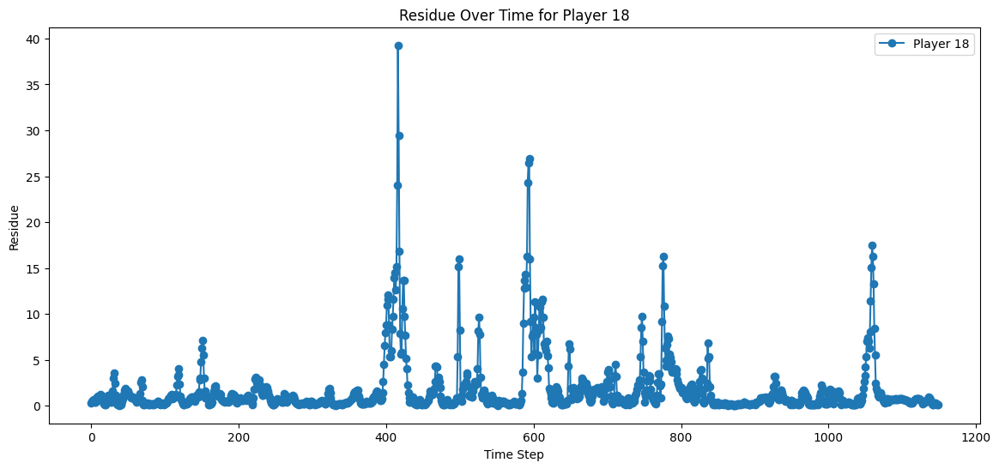

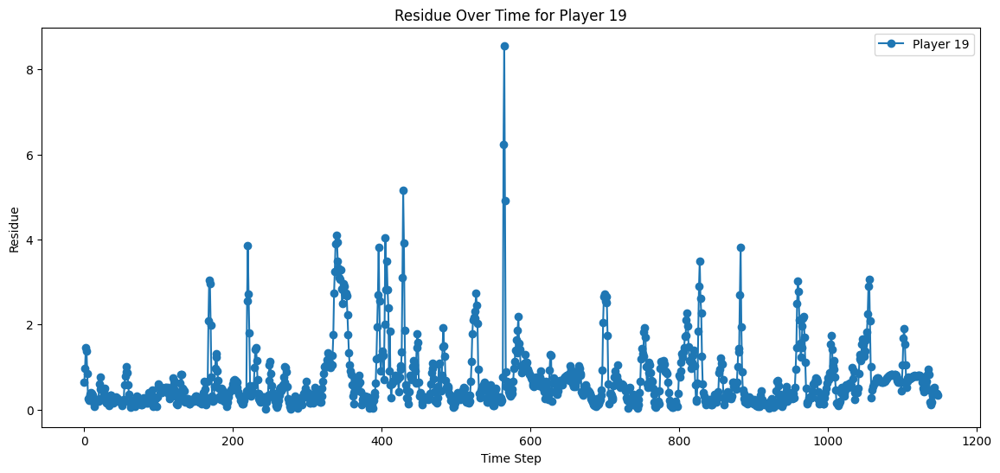

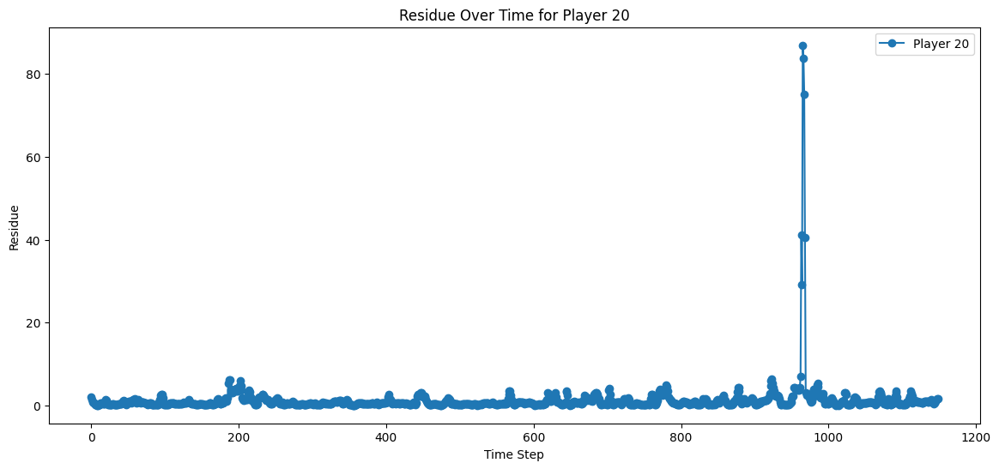

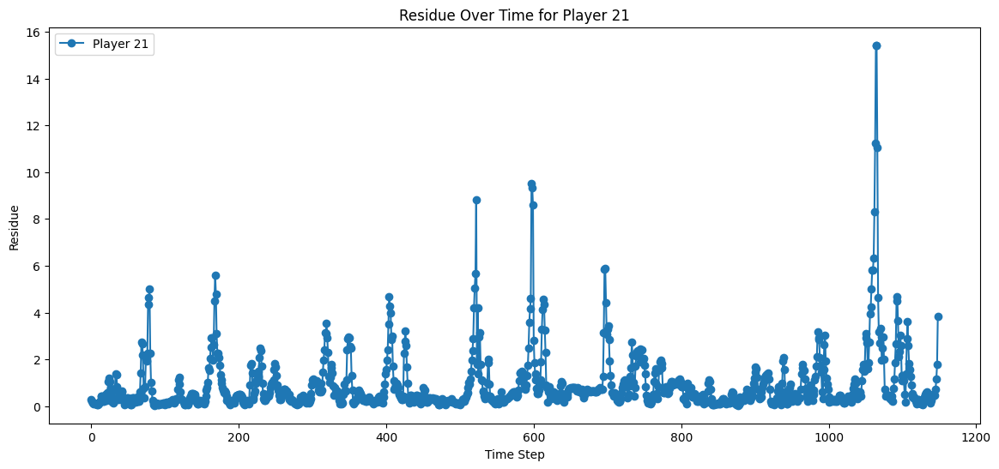

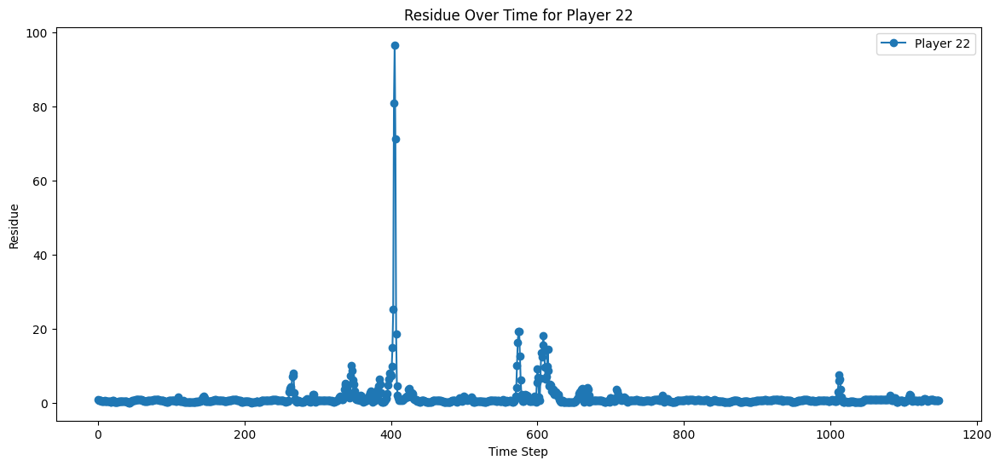

In [47]:
# Plotting the residue over time for each player
num_players = residue_all_samples.shape[2]
time_steps = residue_all_samples.shape[0]

for player in range(num_players):
    plt.figure(figsize=(14, 6))
    plt.plot(np.arange(time_steps), residue_all_samples[:, :, player].mean(axis=1), 'o-', label=f'Player {player + 1}')
    plt.xlabel('Time Step')
    plt.ylabel('Residue')
    plt.title(f'Residue Over Time for Player {player + 1}')
    plt.legend()
    plt.show()

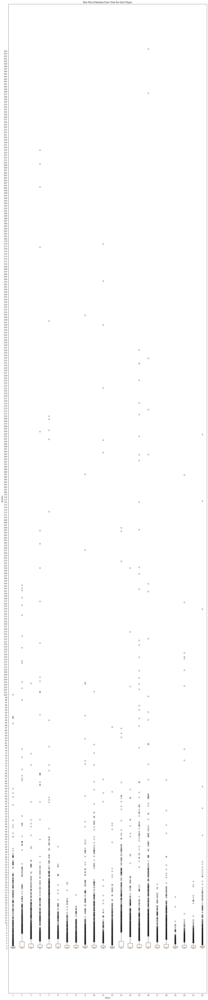

In [48]:
# Plotting box plots for the residue over time for each player
num_players = residue_all_samples.shape[2]
time_steps = residue_all_samples.shape[0]

# Create box plots for each player
plt.figure(figsize=(20, 100))
plt.boxplot([residue_all_samples[:, :, player].flatten() for player in range(num_players)])
plt.xlabel('Player')
plt.ylabel('Residue')
plt.title('Box Plot of Residue Over Time for Each Player')
plt.xticks(np.arange(1, num_players + 1), labels=np.arange(1, num_players + 1))
plt.yticks(np.arange(0, int(residue_all_samples.max()) + 1, 1))
plt.show()

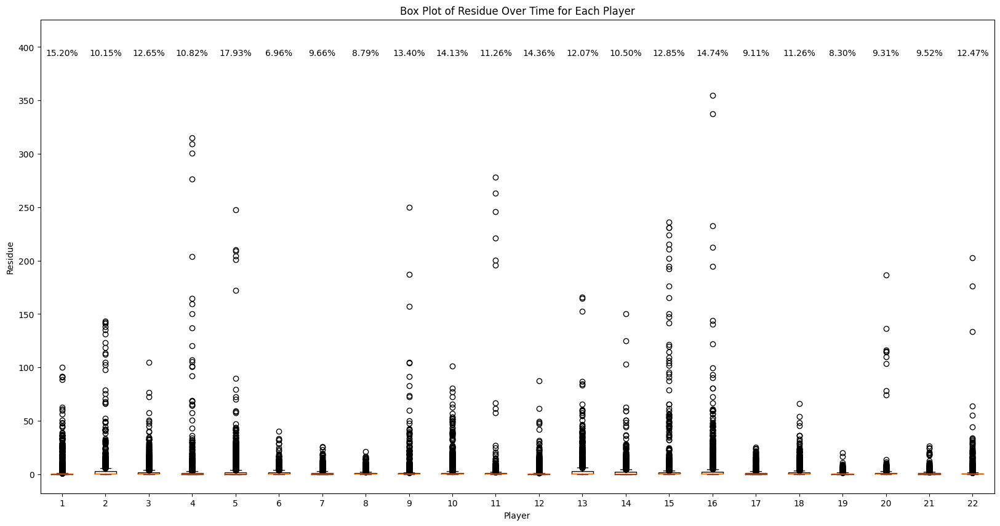

In [49]:
# Calculate the proportion of outliers for each player
outliers_proportion = []
for player in range(residue_all_samples.shape[2]):
    data = residue_all_samples[:, :, player].flatten()
    q1 = np.percentile(data, 25)
    q3 = np.percentile(data, 75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = data[(data < lower_bound) | (data > upper_bound)]
    proportion = len(outliers) / len(data)
    outliers_proportion.append(proportion)

# Create box plots for each player
plt.figure(figsize=(20, 10))
boxplot = plt.boxplot([residue_all_samples[:, :, player].flatten() for player in range(residue_all_samples.shape[2])])

# Add some space at the top of the plot
plt.ylim(top=residue_all_samples.max() * 1.2)

# Add the proportion of outliers as text above each box
for i, proportion in enumerate(outliers_proportion):
    plt.text(i + 1, residue_all_samples.max() * 1.1, f'{proportion:.2%}', ha='center', va='bottom', fontsize=10)

plt.xlabel('Player')
plt.ylabel('Residue')
plt.title('Box Plot of Residue Over Time for Each Player')
plt.xticks(np.arange(1, residue_all_samples.shape[2] + 1), labels=np.arange(1, residue_all_samples.shape[2] + 1))
# plt.yticks(np.arange(0, int(residue_all_samples.max()) + 1, 1))
plt.show()

In [50]:
# Calculate the average residue for all players combined
average_residue_all_players = np.mean(residue_all_samples)

In [51]:
model_parameters = {
    'model': 'base',
    'aggregation': 'add',
    'game': 3,
    'true_influences_all_samples': true_influences_all_samples,
    'predicted_influences_all_samples': predicted_influences_all_samples,
    'residue_all_samples': residue_all_samples,
    'mean_residue_per_player': mean_residue_per_player,
    'average_residue_all_players': average_residue_all_players,
    'median_residue_per_player': median_residue_per_player
}

# Specify the file name
filename = r'saved_results\base_add_3.pkl'

# Save the variables to a file
with open(filename, 'wb') as file:
    pickle.dump(model_parameters, file)

print(f'Model parameters saved to {filename}')

Model parameters saved to saved_results\base_add_1.pkl
